<a href="https://colab.research.google.com/github/briannalizbinoy/My-Projects/blob/main/Aperture%26DifferentialPhotometry.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
from astropy.io import fits
import matplotlib.pyplot as plt
from astropy.wcs.utils import skycoord_to_pixel
from astropy.wcs.utils import pixel_to_skycoord
from astropy.coordinates import SkyCoord
from scipy.optimize import curve_fit
from astropy.wcs import WCS
from os import listdir
from os.path import isfile, join
from datetime import datetime
import math
plt.rcParams.update({'font.size': 12})
from matplotlib.colors import LogNorm
import warnings
warnings.filterwarnings('ignore', category=UserWarning, append=True)
import astropy
from astropy.coordinates import SkyCoord
from astropy.wcs.utils import skycoord_to_pixel
plt.style.use('seaborn-dark-palette')
import os

warnings.filterwarnings("ignore", category=astropy.wcs.FITSFixedWarning)

<ipython-input-68-f784d5a3087a>:20: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-dark-palette')


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


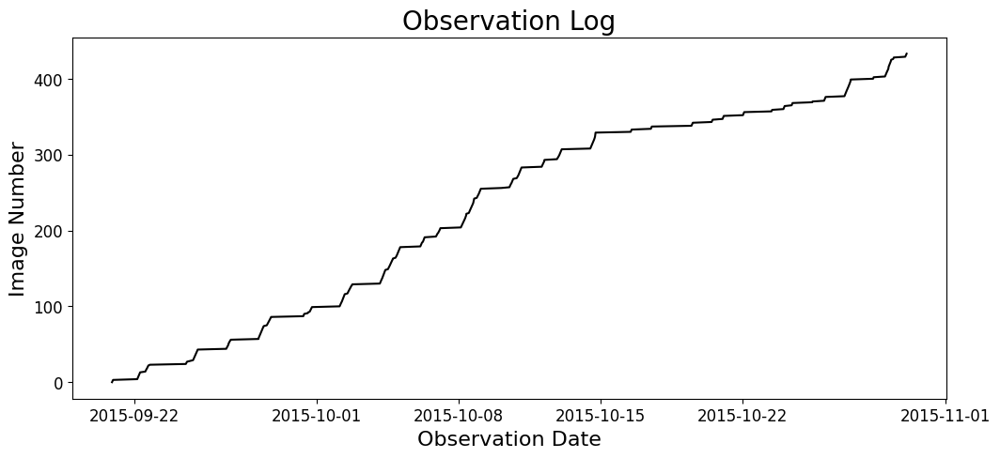

['AST325-326-SN-20150920.9014.fits' 'AST325-326-SN-20150920.9181.fits'
 'AST325-326-SN-20150920.9361.fits' 'AST325-326-SN-20150920.9535.fits'
 'AST325-326-SN-20150922.1458.fits' 'AST325-326-SN-20150922.1618.fits'
 'AST325-326-SN-20150922.1757.fits' 'AST325-326-SN-20150922.1924.fits'
 'AST325-326-SN-20150922.2083.fits' 'AST325-326-SN-20150922.2243.fits'
 'AST325-326-SN-20150922.2410.fits' 'AST325-326-SN-20150922.2569.fits'
 'AST325-326-SN-20150922.2736.fits' 'AST325-326-SN-20150922.2889.fits'
 'AST325-326-SN-20150922.5444.fits' 'AST325-326-SN-20150922.5604.fits'
 'AST325-326-SN-20150922.5778.fits' 'AST325-326-SN-20150922.6014.fits'
 'AST325-326-SN-20150922.6236.fits' 'AST325-326-SN-20150922.6410.fits'
 'AST325-326-SN-20150922.6569.fits' 'AST325-326-SN-20150922.6757.fits'
 'AST325-326-SN-20150922.6944.fits' 'AST325-326-SN-20150922.7722.fits'
 'AST325-326-SN-20150924.5410.fits' 'AST325-326-SN-20150924.5611.fits'
 'AST325-326-SN-20150924.5806.fits' 'AST325-326-SN-20150924.5986.fits'
 'AST3

In [ ]:
img_files = [f for f in listdir('/content/drive/MyDrive/ASTFitsFiles') if isfile(join('/content/drive/MyDrive/ASTFitsFiles', f)) and 'fits' in f]

file_times = []
for f in img_files:
    header = fits.open('/content/drive/MyDrive/ASTFitsFiles/'+str(f))[0].header
    dt = datetime.fromisoformat(header["DATE-OBS"])
    w = WCS(header)
    file_times.append(dt)

file_times, img_files = zip(*sorted(zip(file_times, img_files)))



img_files = np.array(img_files)
file_times = np.array(file_times)

plt.figure(figsize=(12,5))
plt.plot(file_times, np.arange(file_times.size), color = 'k')
plt.ylabel("Image Number", size = 16)
plt.xlabel("Observation Date", size = 16)
plt.title("Observation Log", size = 20)
plt.show()

print(img_files)


In [ ]:
print(img_files[2])

AST325-326-SN-20150920.9361.fits


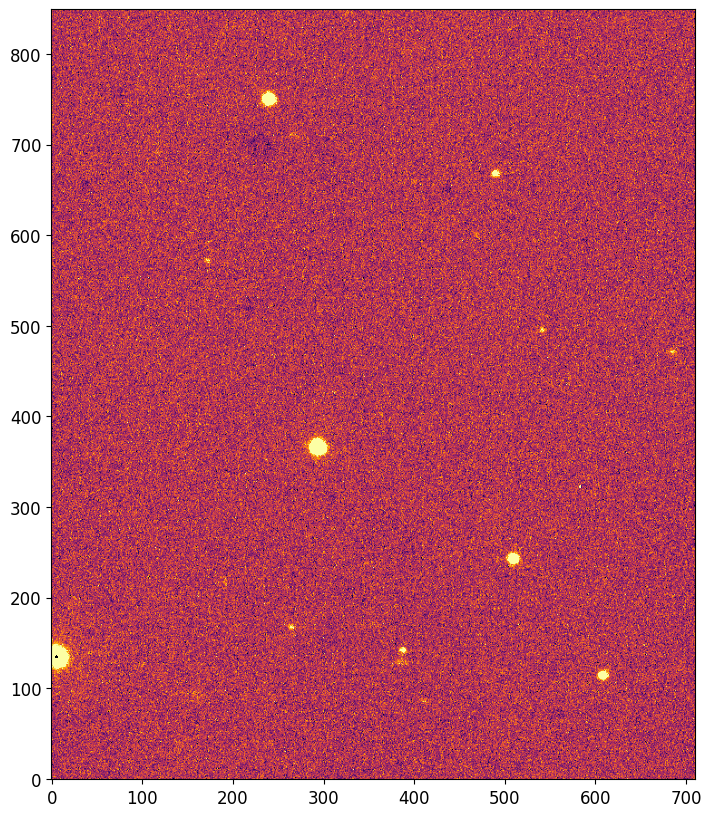

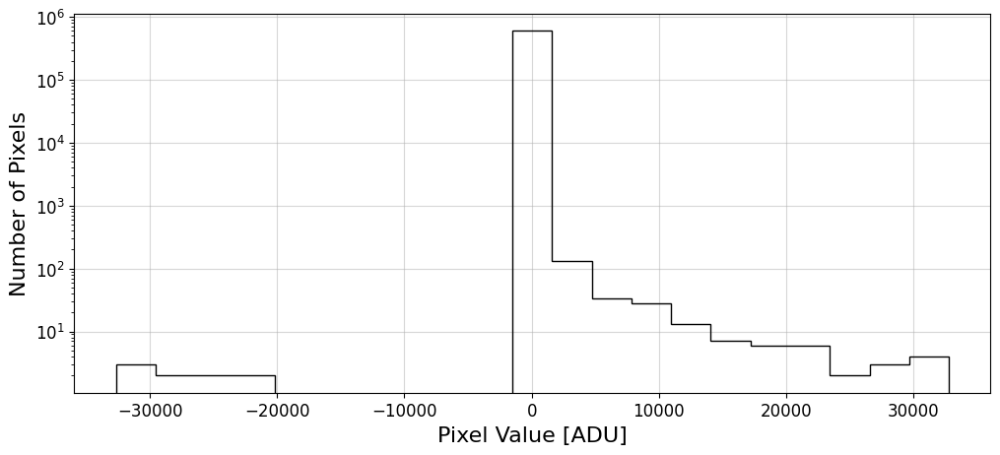

MAX VALUE 32766
MIN VALUE -32672


In [ ]:
def read_file1(filename):
    return fits.open('/content/drive/MyDrive/ASTFitsFiles/'+str(filename))[0].data

data1 = read_file1('AST325-326-SN-20151026.0264.fits')
plt.figure(figsize=(10,10))
plt.imshow(data1,
           vmin = -100,
           vmax = 1e2,
           origin = 'lower',
           cmap = 'inferno')
plt.show()

plt.figure(figsize=(12,5))
plt.hist(data1.flatten(), bins = 'sturges', color = 'k', histtype='step')
plt.grid(alpha=0.5)
plt.yscale('log')
plt.xlabel("Pixel Value [ADU]", size = 16)
plt.ylabel("Number of Pixels", size = 16)
plt.show()

print(f"MAX VALUE {np.max(data1)}\nMIN VALUE {np.min(data1)}")
row = np.where(data1 == np.min(data1))[0][0]

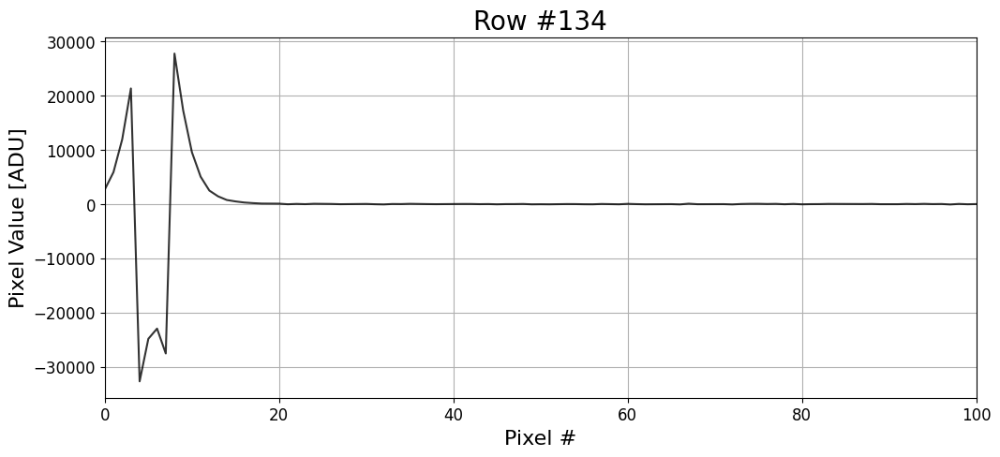

In [ ]:
plt.figure(figsize= (12,5))
plt.plot(data1[row,:], color = 'k', alpha = 0.8)
# plt.ylim(-33e3,25e3)
plt.xlim(0,100)
plt.title(f"Row #{row}", size = 20)
plt.grid()
plt.ylabel("Pixel Value [ADU]", size = 16)
plt.xlabel("Pixel #", size = 16)
plt.show()

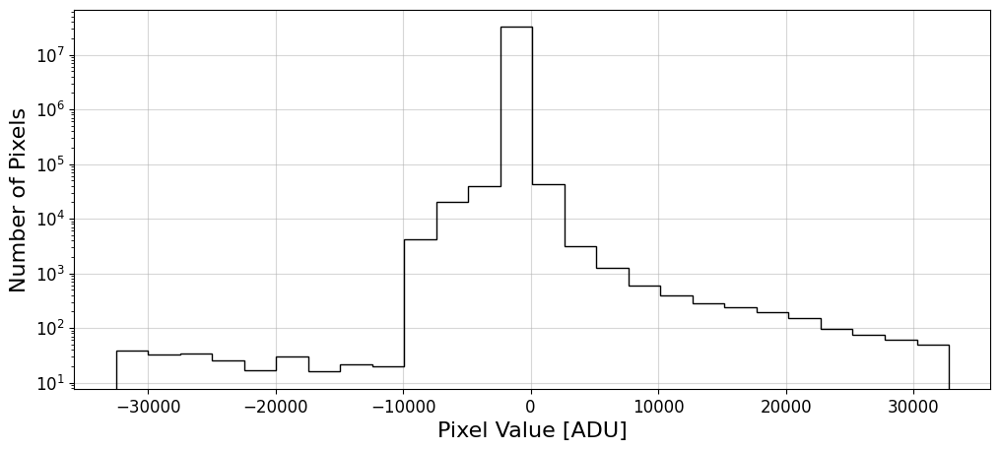

In [ ]:
full_data = np.empty((len(img_files)//8, *data1.shape), dtype = data1.dtype)
for i, file in enumerate(img_files[:len(img_files)//8]):
    full_data[i] = read_file1(img_files[i])

plt.figure(figsize=(12,5))
plt.hist(full_data.flatten(), bins = 'sturges', color = 'k', histtype='step')
plt.grid(alpha=0.5)
plt.yscale('log')
plt.xlabel("Pixel Value [ADU]", size = 16)
plt.ylabel("Number of Pixels", size = 16)
plt.show()

del full_data

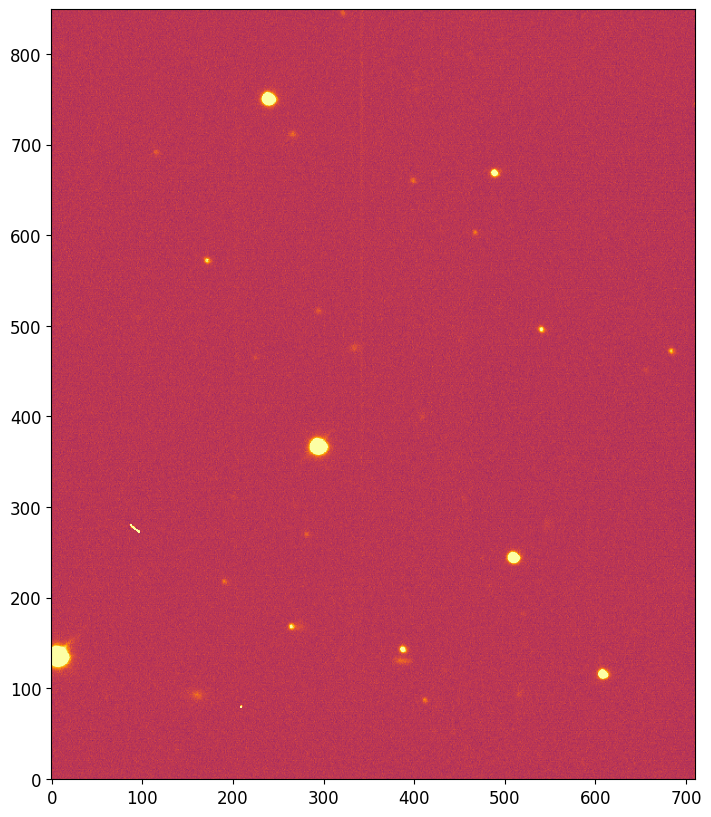

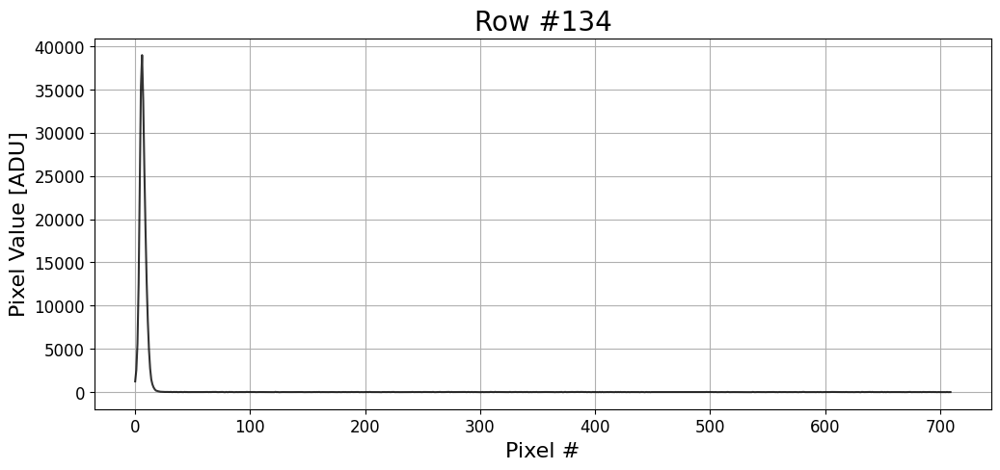

MAX VALUE 43253
MIN VALUE -138


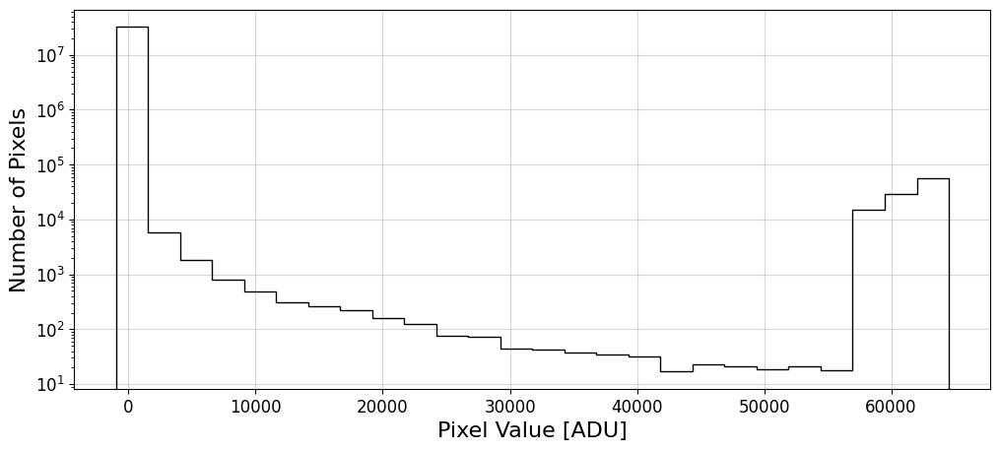

In [ ]:
def read_file(filename):
    hdu = fits.open('/content/drive/MyDrive/ASTFitsFiles/'+str(filename))[0]
    data = hdu.data.astype(int)
    data[data < -1e3] = ((2**15-1)-np.abs(data[data < -1e3])) + (2**15-1)
    return data

data1 = read_file('AST325-326-SN-20150920.9535.fits')
plt.figure(figsize=(10,10))
plt.imshow(data1,
           vmin = -100,
           vmax = 1e2,
           origin = 'lower',
           cmap = 'inferno')
plt.show()

plt.figure(figsize= (12,5))
plt.plot(data1[row,:], color = 'k', alpha = 0.8)
# plt.ylim(-100,40e3)
# plt.xlim(1000,1200)
plt.title(f"Row #{row}", size = 20)
plt.grid()
plt.ylabel("Pixel Value [ADU]", size = 16)
plt.xlabel("Pixel #", size = 16)
plt.show()

print(f"MAX VALUE {np.max(data1)}\nMIN VALUE {np.min(data1)}")

full_data = np.empty((len(img_files)//8, *data1.shape), dtype = data1.dtype)
for i, file in enumerate(img_files[:len(img_files)//8]):
    full_data[i] = read_file(img_files[i])

plt.figure(figsize=(12,5))
plt.hist(full_data.flatten(), bins = 'sturges', color = 'k', histtype='step')
plt.grid(alpha=0.5)
plt.yscale('log')
plt.xlabel("Pixel Value [ADU]", size = 16)
plt.ylabel("Number of Pixels", size = 16)
plt.show()

del full_data

<SkyCoord (ICRS): (ra, dec) in deg
    (14.19345833, -37.04152778)>
(array(608.67176587), array(115.64012573))


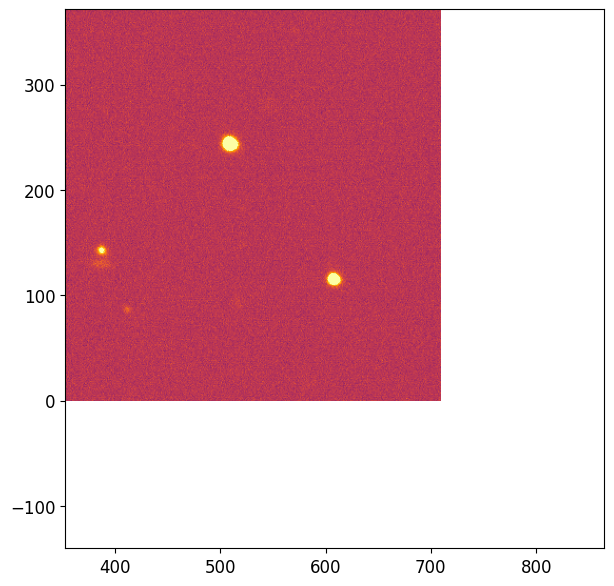

In [ ]:
from astropy.wcs import WCS
from astropy.coordinates import SkyCoord
from astropy.wcs.utils import skycoord_to_pixel


header = fits.open('/content/drive/MyDrive/ASTFitsFiles/'+str(img_files[2]))[0].header
data  = read_file(img_files[2])

w = WCS(header)
ref_b = SkyCoord('00h56m49.70s', '-37d01m38.31s')
ref_b = SkyCoord('00h56m46.43s', '-37d02m29.50s')
print(ref_b)
ref_pos = skycoord_to_pixel(ref_b, w)
print(ref_pos)
plt.figure(figsize = (7,7))
plt.imshow(data, origin = 'lower',
           cmap = 'inferno', vmin = -100, vmax = 100
           )
plt.xlim(ref_pos[0]-256, ref_pos[0]+256)
plt.ylim(ref_pos[1]-256, ref_pos[1]+256)
# plt.axhline(ref_pos[0], color = 'blue')
# plt.axvline(ref_pos[1],color = 'blue')
# plt.colorbar()
plt.show()

AST325-326-SN-20150924.7465.fits


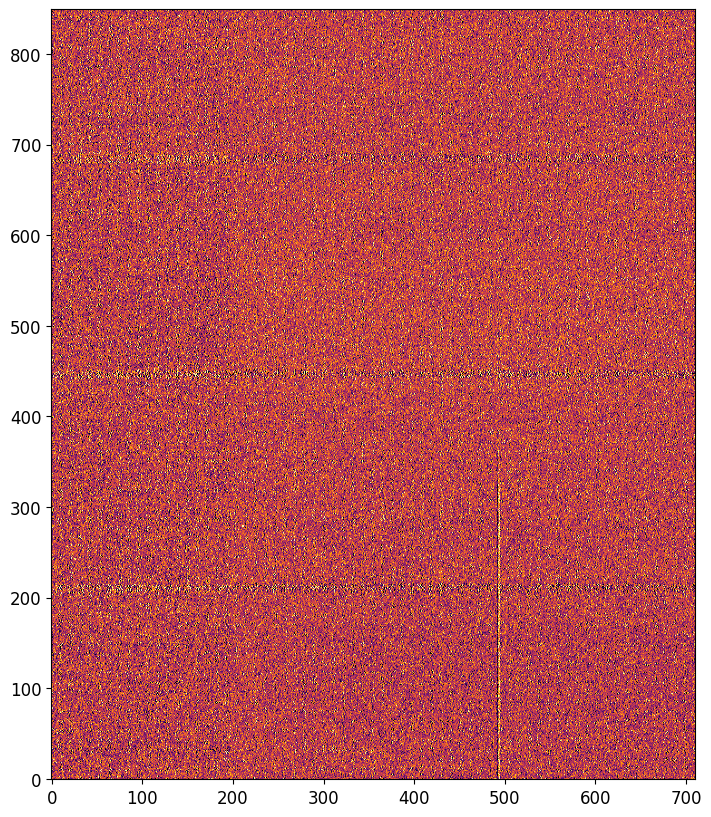

AST325-326-SN-20150930.5694.fits


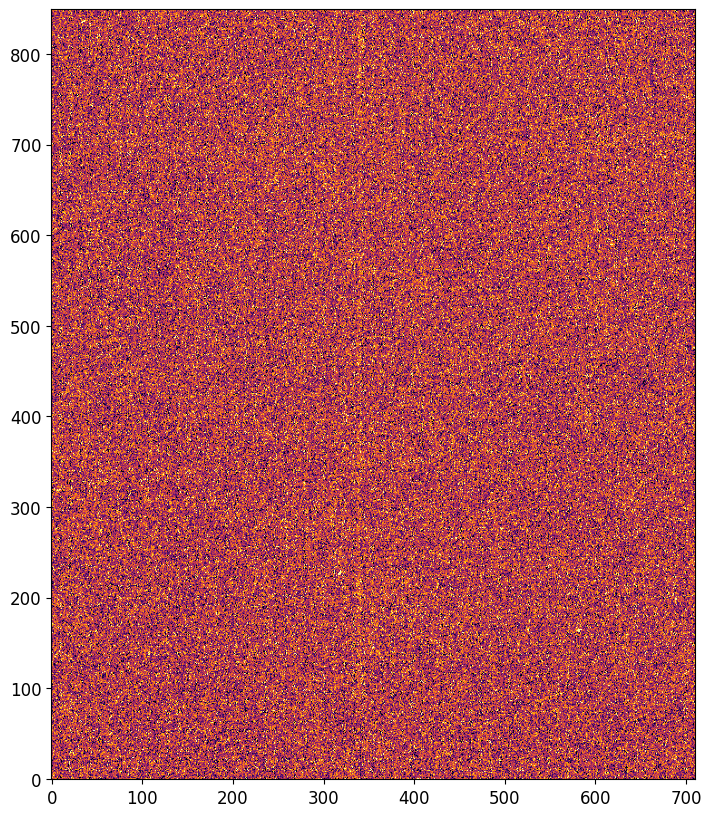

AST325-326-SN-20150930.6694.fits


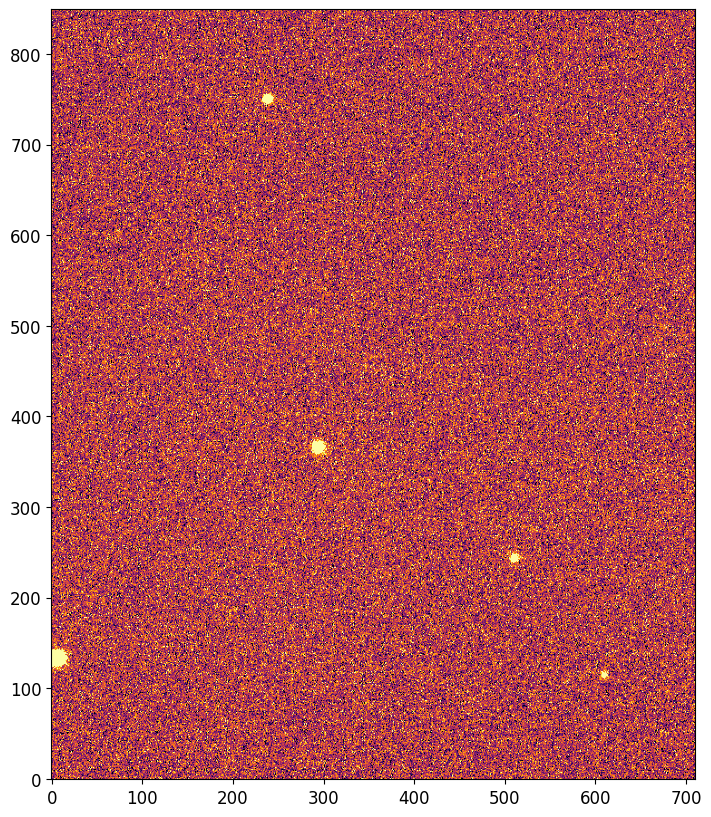

AST325-326-SN-20151004.6194.fits


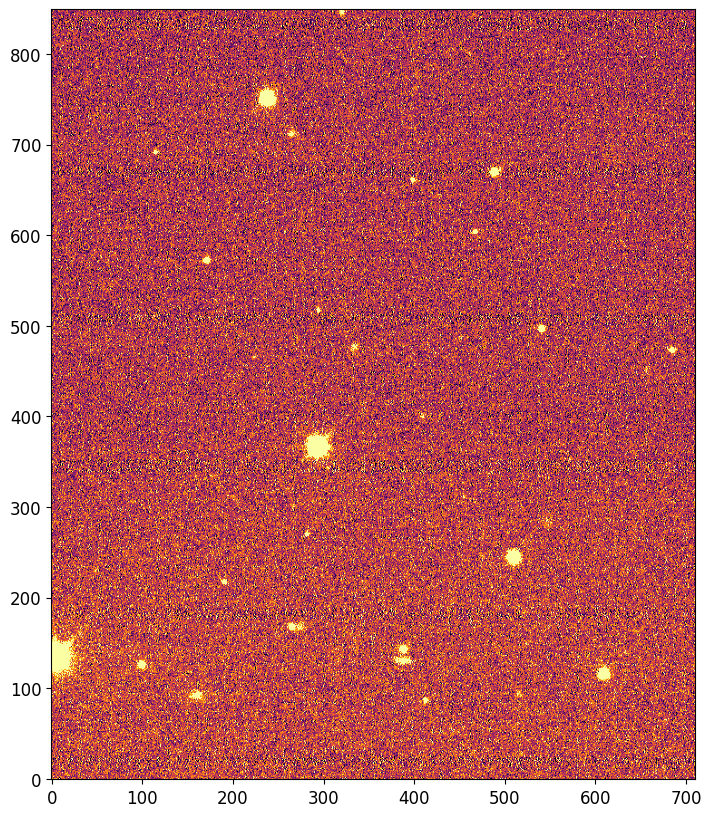

AST325-326-SN-20151006.9146.fits


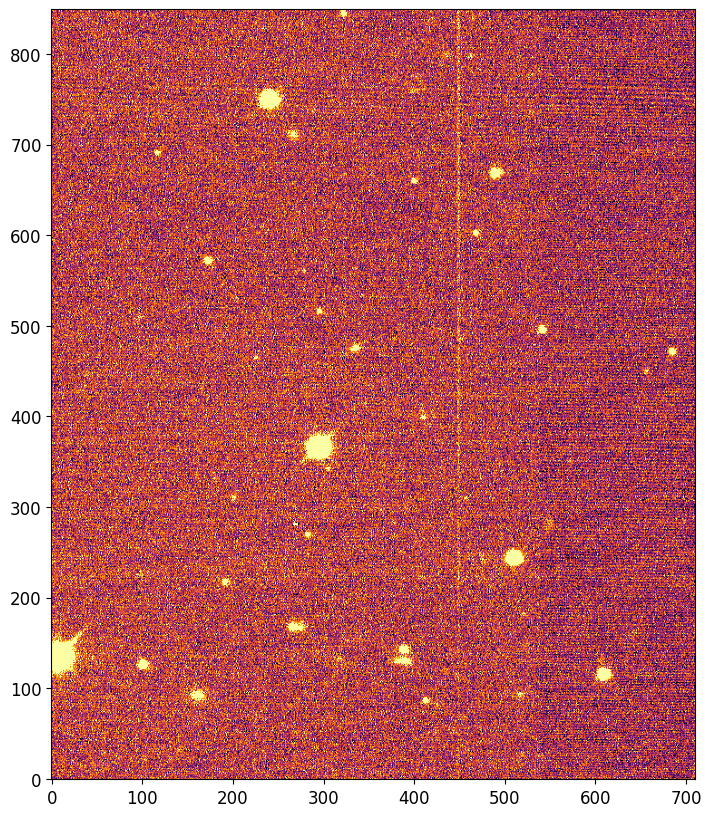

AST325-326-SN-20151008.9813.fits


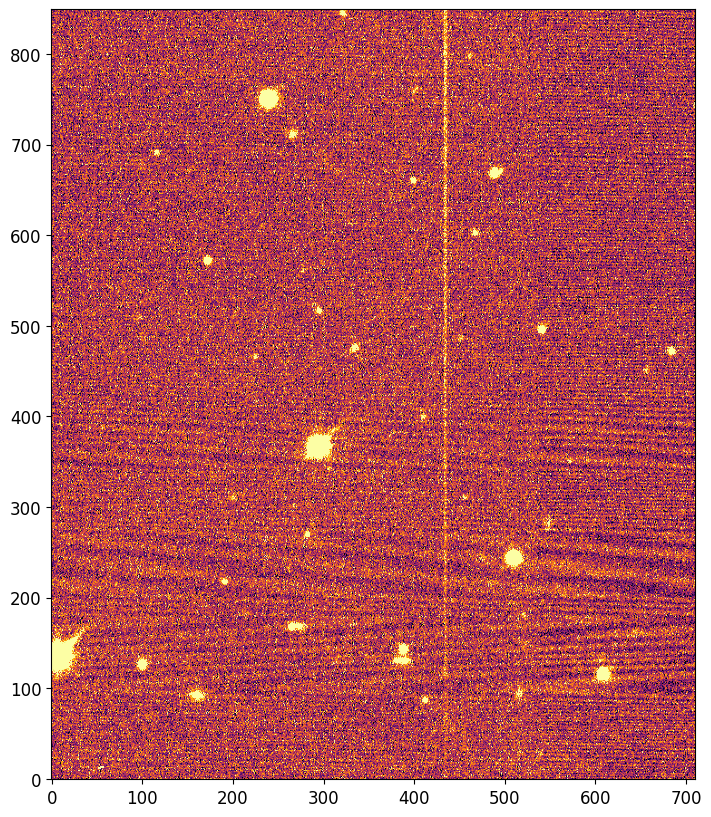

AST325-326-SN-20151004.5653.fits


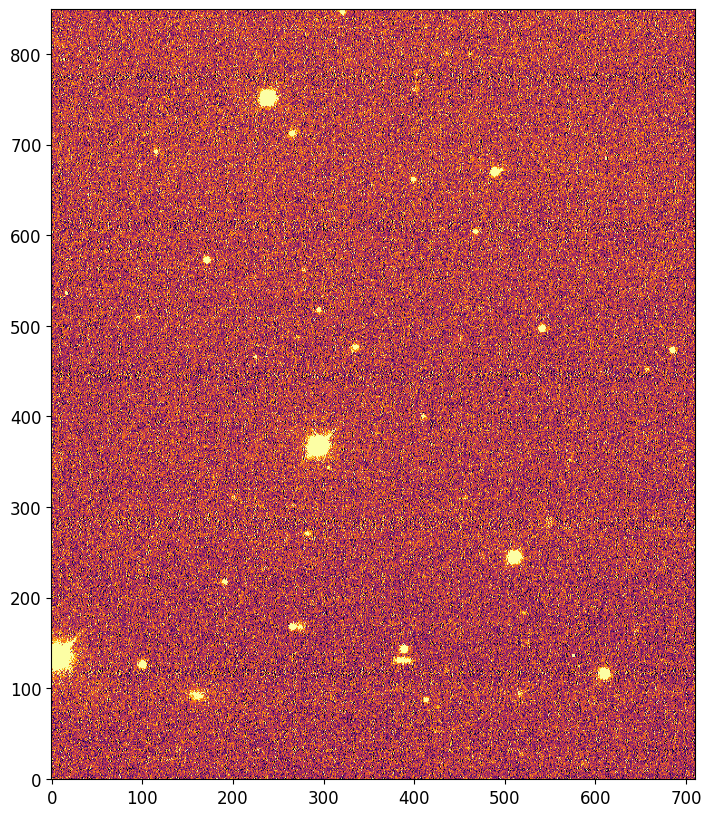

AST325-326-SN-20151004.8792.fits


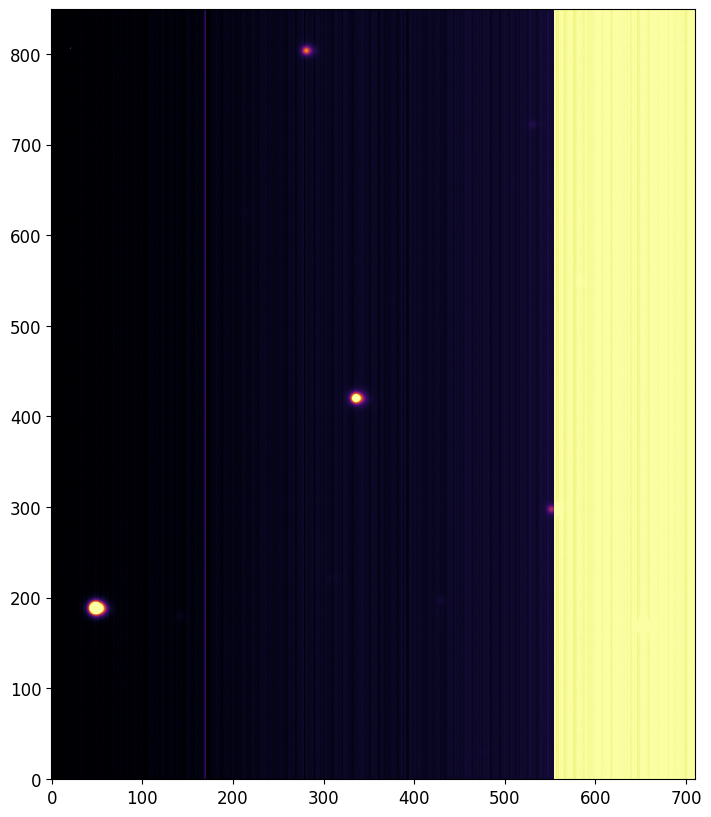

AST325-326-SN-20151008.9597.fits


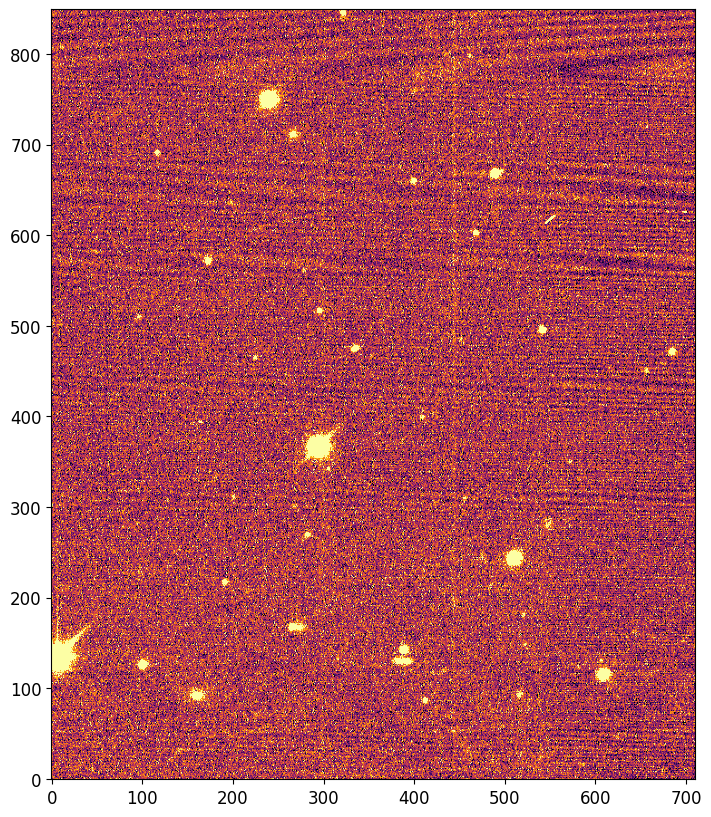

AST325-326-SN-20151026.0403.fits


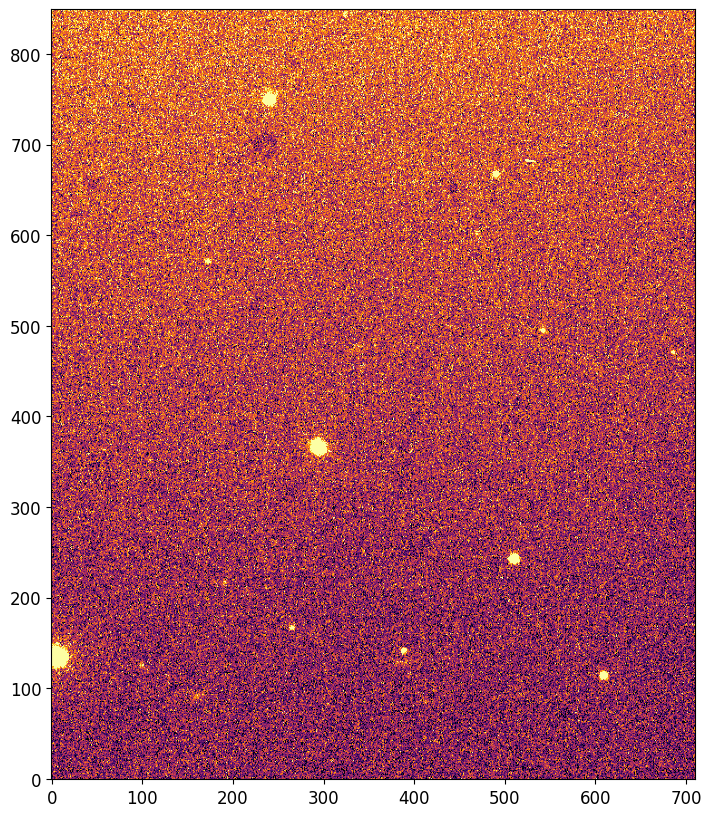

AST325-326-SN-20151026.0549.fits


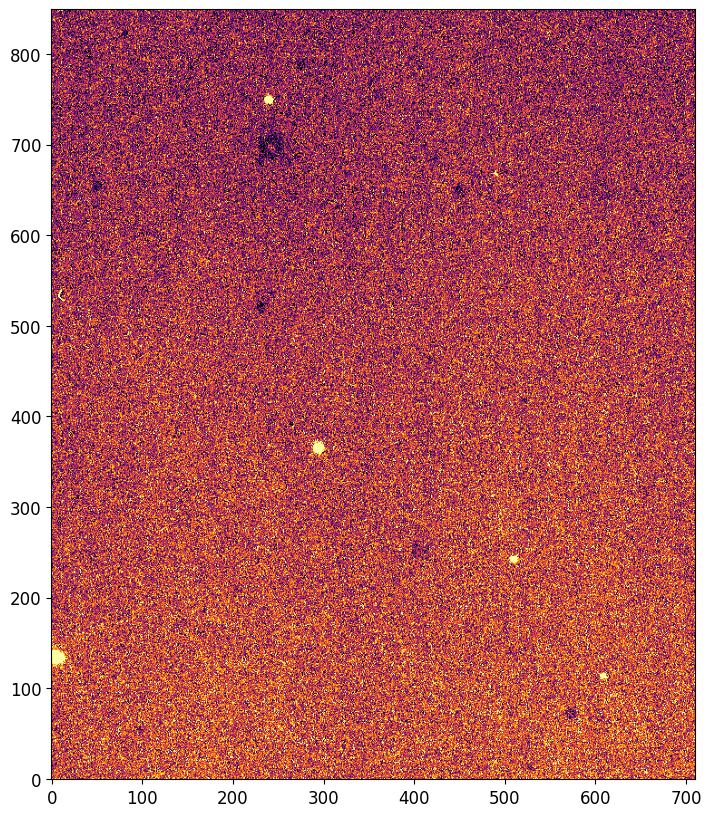

AST325-326-SN-20151012.8410.fits


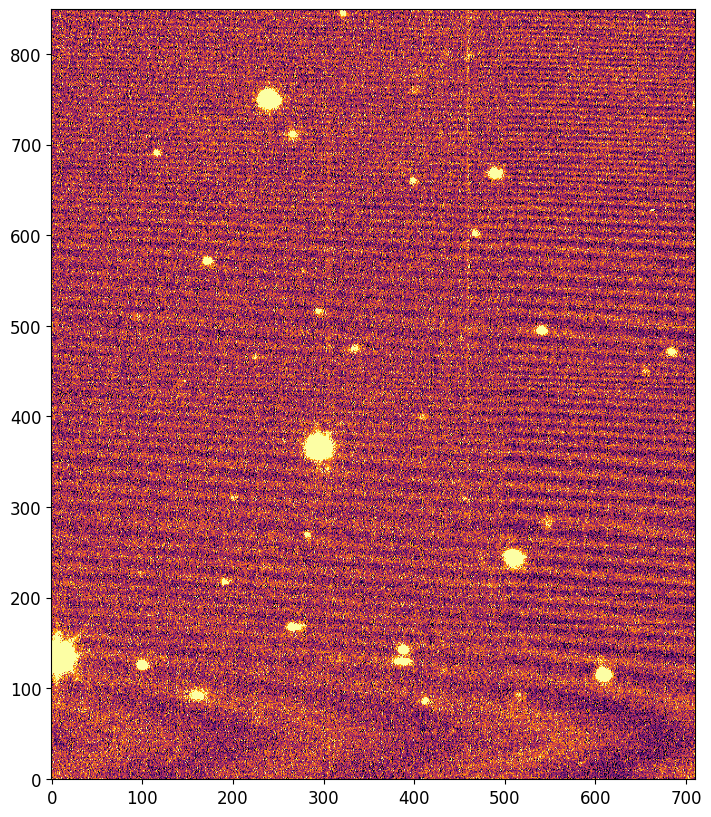

AST325-326-SN-20151012.8410.fits


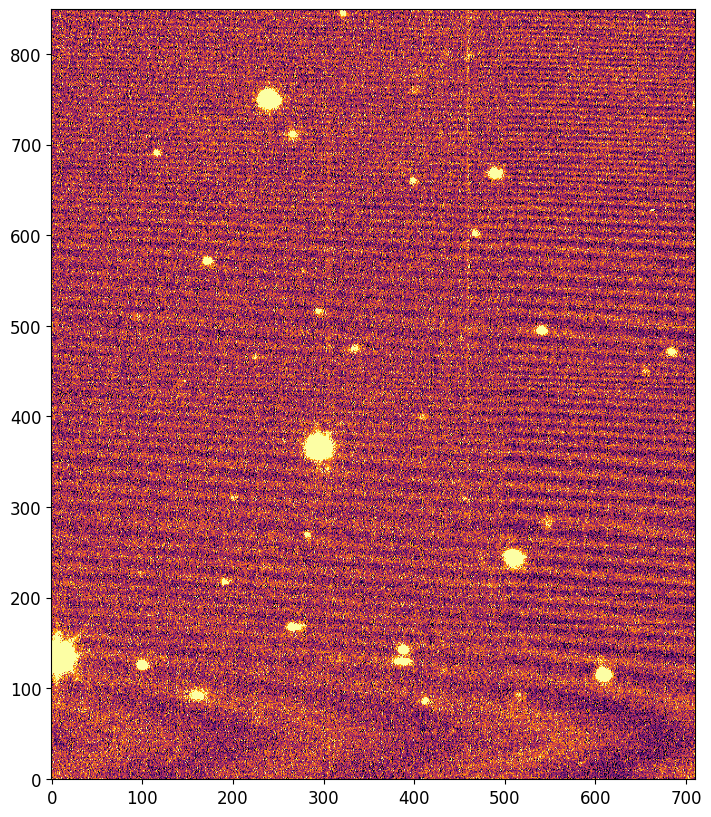

AST325-326-SN-20151004.6354.fits


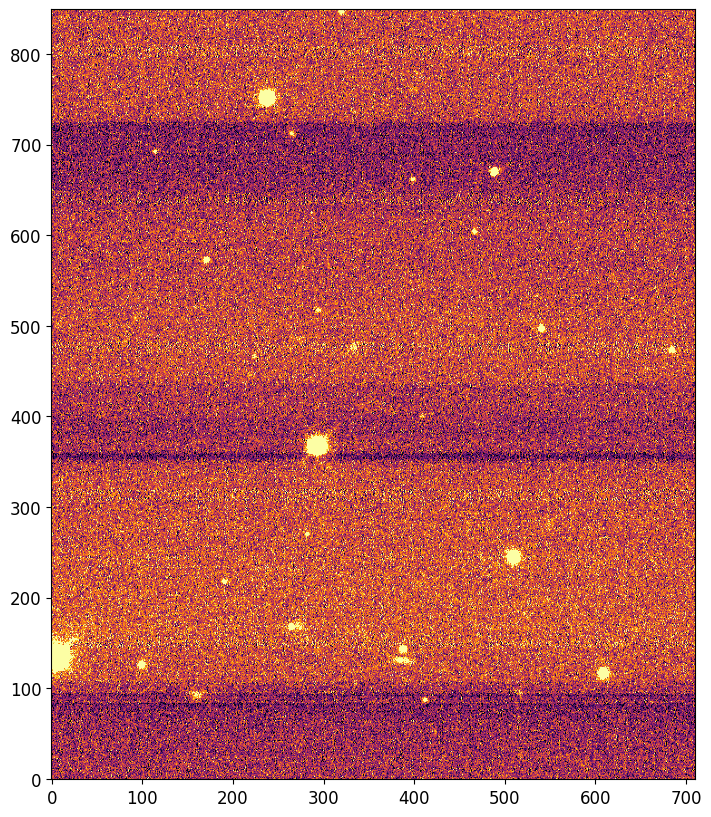

AST325-326-SN-20151010.8764.fits


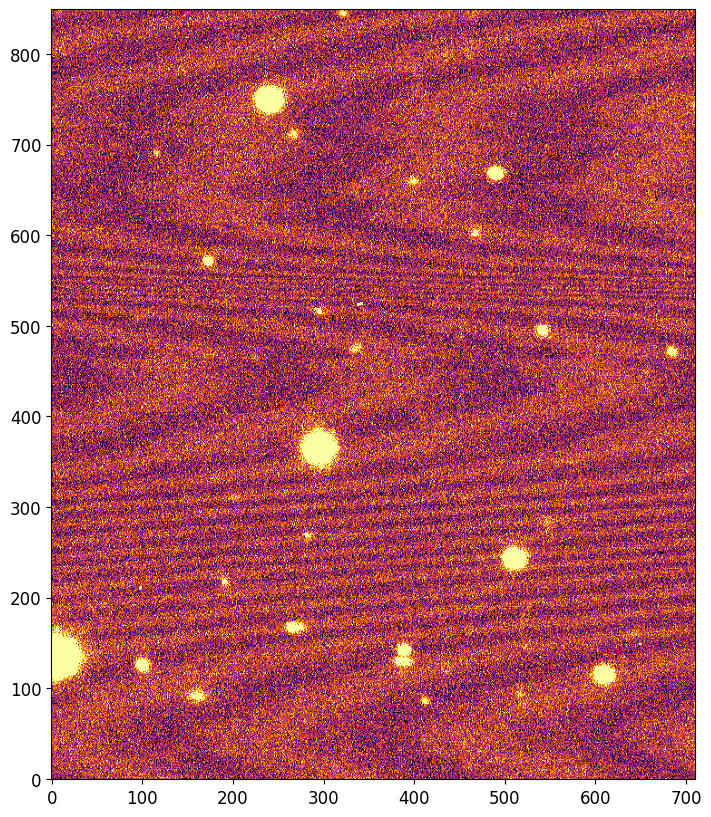

AST325-326-SN-20151011.0174.fits


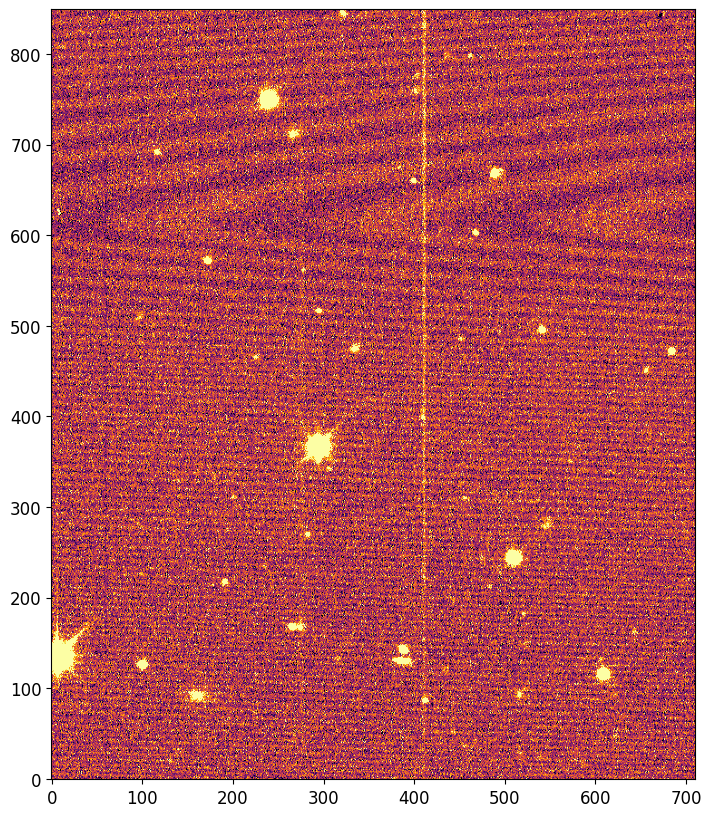

AST325-326-SN-20151011.0479.fits


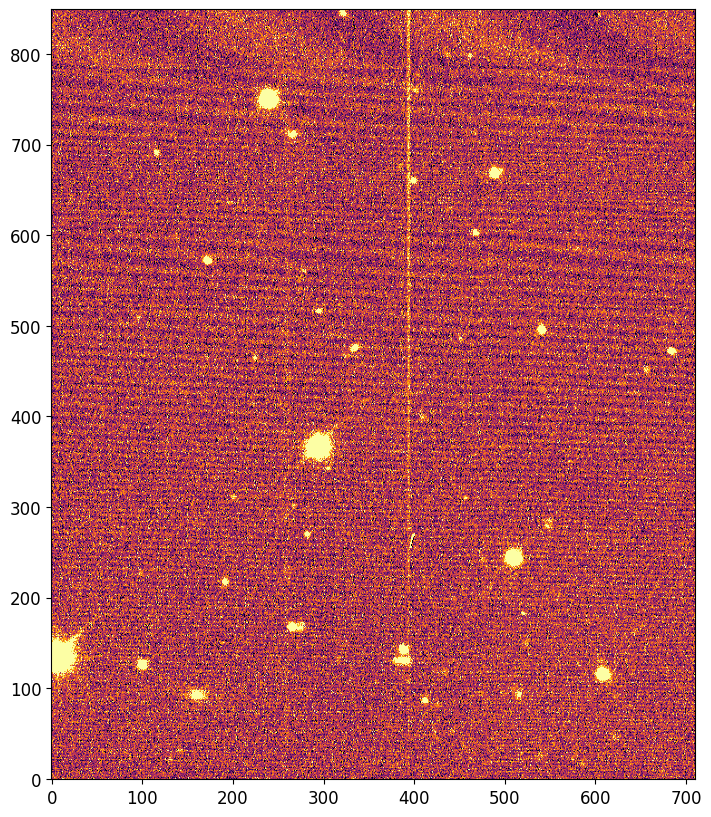

AST325-326-SN-20151017.4861.fits


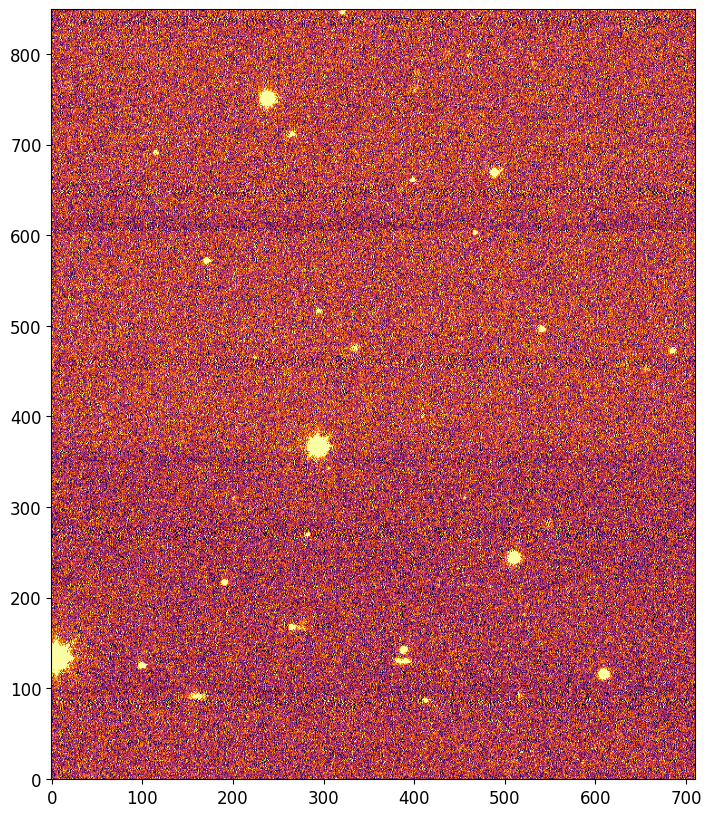

AST325-326-SN-20151029.4160.fits


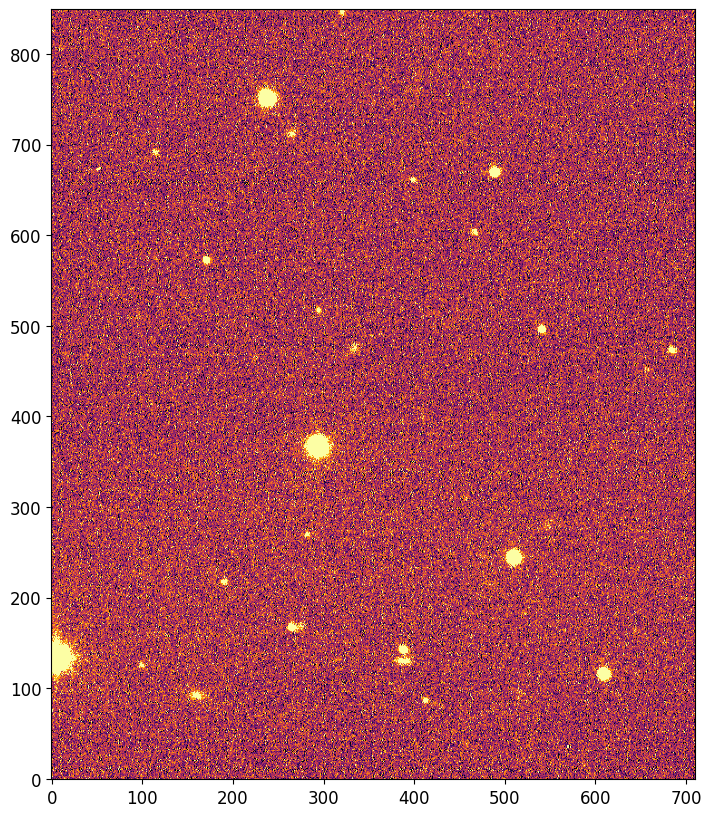

In [ ]:
def plot_image(filename):
    data1 = read_file(filename)
    plt.figure(figsize=(10,10))
    plt.imshow(data1,
               vmin = np.percentile(data1,5),
               vmax = np.percentile(data1,95),
               origin = 'lower',
               cmap = 'inferno')
    plt.show()


examples = ['AST325-326-SN-20150924.7465.fits',
            'AST325-326-SN-20150930.5694.fits',
'AST325-326-SN-20150930.6694.fits','AST325-326-SN-20151004.6194.fits',
'AST325-326-SN-20151006.9146.fits', 'AST325-326-SN-20151008.9813.fits',
'AST325-326-SN-20151004.5653.fits', 'AST325-326-SN-20151004.8792.fits',
'AST325-326-SN-20151008.9597.fits', 'AST325-326-SN-20151026.0403.fits',
'AST325-326-SN-20151026.0549.fits', 'AST325-326-SN-20151012.8410.fits',
'AST325-326-SN-20151012.8410.fits', 'AST325-326-SN-20151004.6354.fits',
'AST325-326-SN-20151010.8764.fits','AST325-326-SN-20151011.0174.fits',
'AST325-326-SN-20151011.0479.fits', 'AST325-326-SN-20151017.4861.fits',
'AST325-326-SN-20151029.4160.fits']




for f in examples:
    print(f)
    plot_image(f)

In [ ]:
from scipy.stats import skew, kurtosis
from skimage.metrics import structural_similarity as ssim
data0 =  read_file(img_files[0])
vars = np.empty(len(img_files))
means = np.empty_like(vars)
skews = np.empty_like(vars)
kurtoses = np.empty_like(vars)
sim = np.empty_like(vars)
for i, f in enumerate(img_files):
    data = read_file(f)
    vars[i] = np.var(data)
    means[i] = np.mean(data)
    skews[i] = skew(data.flatten())
    kurtoses[i] = kurtosis(data.flatten())
    sim[i] = ssim(data0, data)

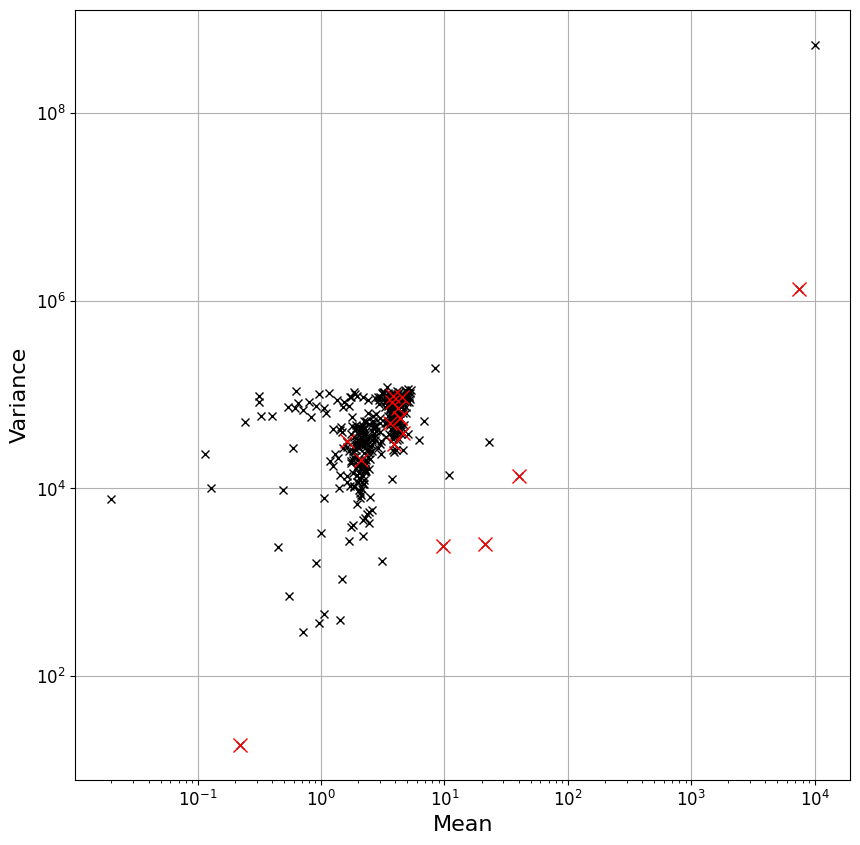

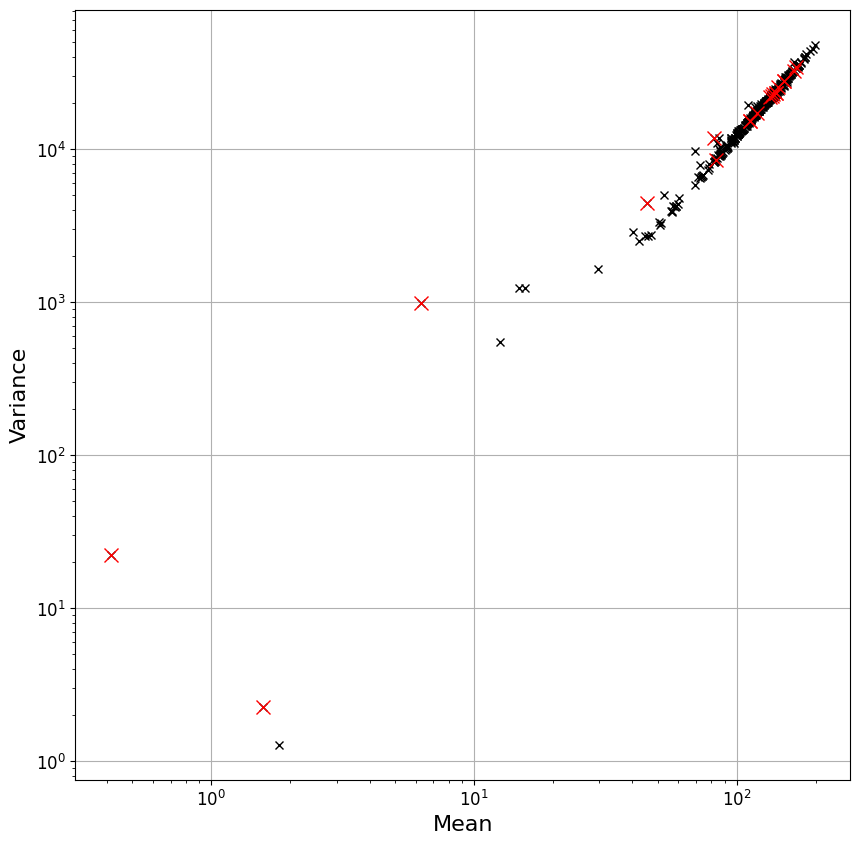

In [ ]:
plt.figure(figsize=(10,10))
plt.plot(means,vars, 'x', color = 'k')
for f in examples:
    data = read_file(f)
    plt.plot(np.mean(data),np.var(data), 'x', color = 'r', ms = 10, label = 'Examples')
plt.yscale('log')
plt.xscale('log')
plt.xlabel("Mean", size = 16)
plt.ylabel("Variance", size = 16)
plt.grid()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(skews,kurtoses, 'x', color = 'k')
for f in examples:
    data = read_file(f)
    plt.plot(skew(data.flatten()),kurtosis(data.flatten()), 'x', color = 'r', ms = 10, label = 'Examples')
plt.yscale('log')
plt.xscale('log')
plt.xlabel("Mean", size = 16)
plt.ylabel("Variance", size = 16)
plt.grid()
plt.show()


In [ ]:
from sklearn.cluster import KMeans
def cluster_image_properties(properties, num_clusters=2):
    """
    Cluster image properties (mean, variance, skew, kurtosis) into groups using KMeans.

    Parameters:
    - properties: a list of arrays containing statistical properties for the N images.
    - num_clusters: The number of clusters for KMeans.

    Returns:
    - cluster_labels: An array of cluster labels for each image property.
    """
    # Combine the properties into a single feature matrix
    feature_matrix = np.column_stack(properties)

    # Apply KMeans clustering
    kmeans = KMeans(n_clusters=num_clusters)
    cluster_labels = kmeans.fit_predict(feature_matrix)

    return cluster_labels
NUM_CLUSTER = 20

labels = cluster_image_properties([means,vars,skews,kurtoses,sim], num_clusters=NUM_CLUSTER)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
print(np.arange(max(labels)+2)+0.5)
plt.hist(labels+1, bins = np.arange(max(labels)+2)+0.5)
plt.show()

for i in range(NUM_CLUSTER):
    print(f"Cluster #{i+1}")
    indices = np.where(labels == i)
    files = img_files[indices]
    for j, f in enumerate(files):
        if j > 2:
            continue
        data = read_file(f)
        plt.figure(figsize=(10,10))
        plt.imshow(data,
                vmin = np.percentile(data,5),
                vmax = np.percentile(data,95),
                origin = 'lower',
                cmap = 'inferno')
        plt.show()

    print(indices)

NameError: ignored

In [ ]:
#img_files = np.delete(img_files, indices)
#file_times = np.delete(file_times, indices)

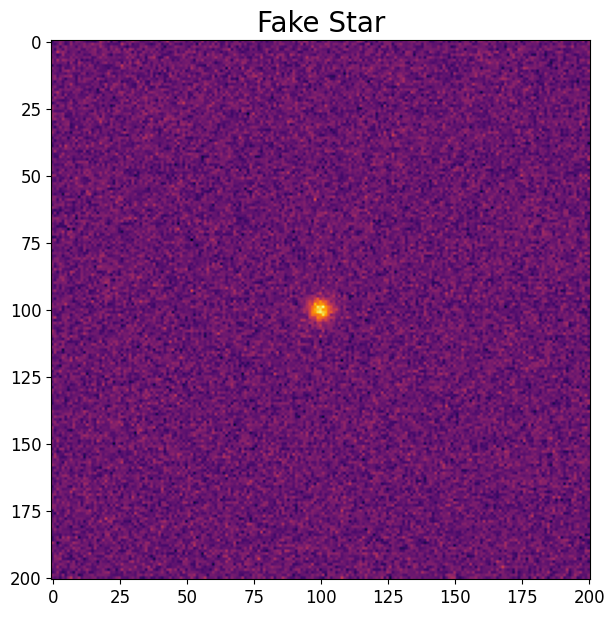

[90.2510062  99.97754961  3.39515528 19.74351322]


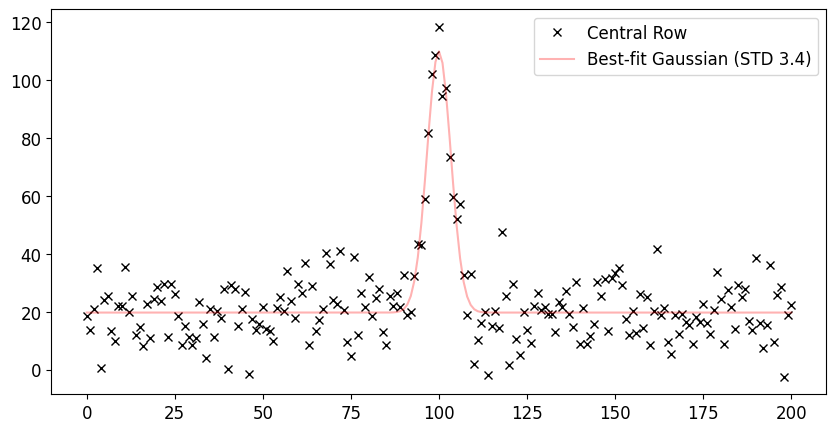

In [ ]:
def two_d_gaussian(x,y,ux,uy,sx,sy,A):
    return A*np.exp(-1*((x-ux)**2/(2*sx**2) + (y-uy)**2/(2*sy**2)))

def gaus(x,a,x0,sigma, c):
    return a*np.exp(-(x-x0)**2/(2*sigma**2)) + c

def fake_star(amplitude, noise):
    axis = np.arange(-100,101).astype(float)
    x,y = np.meshgrid(axis,axis)

    data = np.zeros_like(x)

    data += two_d_gaussian(x,y,0,0,3,3,amplitude)

    return data + np.random.normal(0, noise, x.shape) + 20

amp = 100
star = fake_star(amp, 10)
plt.figure(figsize=(7,7))
plt.imshow(star, cmap = 'inferno')
plt.title("Fake Star", size = 20)
plt.show()

#Now we can fit a Gaussian to the star image
x, y = np.arange(star.shape[0]), star[star.shape[0]//2,:]
popt, pcov = curve_fit(gaus,
                       x,y,
                       p0=[amp,star.shape[0]//2,10, 0])
print(popt)
plt.figure(figsize=(10,5))
plt.plot(x,y, 'x', color = 'k', label = 'Central Row')
plt.plot(x,gaus(x,*popt),color = 'r', alpha = 0.3, label = f'Best-fit Gaussian (STD {round(popt[2],1)})')
plt.legend()
plt.show()

[1492.97637499   52.05453883    2.72358847    5.36054056]


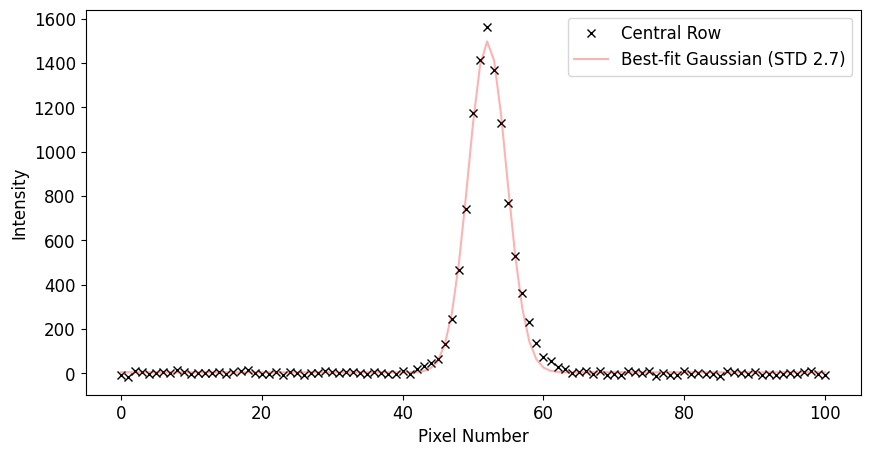

[692.15192226  49.78000429   2.75383604   2.40775996]


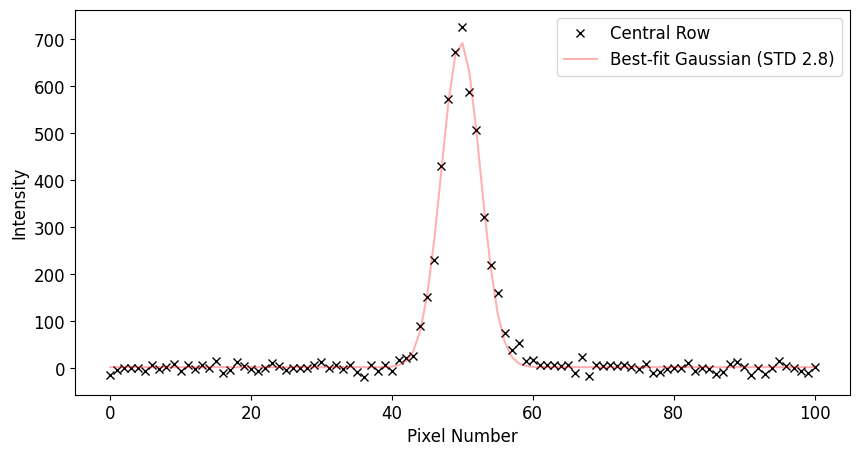

[2762.0851135    50.9978956    -2.77236803    8.28170921]


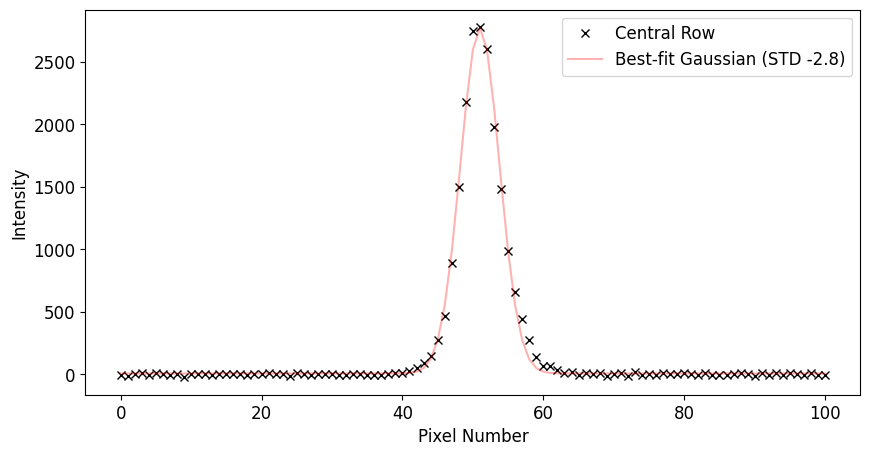

In [ ]:
data  = read_file(img_files[2])
header = fits.open('/content/drive/MyDrive/ASTFitsFiles/'+str(img_files[2]))[0].header
w = WCS(header)
stars = np.array([SkyCoord('00h56m49.70s', '-37d01m38.31s'),  SkyCoord('00h56m46.43s', '-37d02m29.50s'), SkyCoord('00h56m58.27s', '-36d58m16.60s')])
ref_stars = [stars[0], stars[1], stars[2]]
boxsize = 50
for j, star in enumerate(ref_stars):

        # locate the star
        ref_pos = skycoord_to_pixel(star, w)
        ref_x, ref_y = ref_pos

        # we can then put look at a box around the star to set up our flux code above
        ref_x_int, ref_y_int = ref_x.astype(int), ref_y.astype(int)

        #generate region around star
        sub_im = data[ref_y_int-boxsize: ref_y_int+boxsize+1,
                      ref_x_int-boxsize: ref_x_int+boxsize+1]
        x, y = np.arange(sub_im.shape[0]), sub_im[sub_im.shape[0]//2,:]
        popt, pcov = curve_fit(gaus,
                              x,y, p0=[45, 50,25, 0])
        print(popt)
        plt.figure(figsize=(10,5))
        plt.plot(x,y, 'x', color = 'k', label = 'Central Row')
        plt.plot(x,gaus(x,*popt),color = 'r', alpha = 0.3, label = f'Best-fit Gaussian (STD {round(popt[2],1)})')
        plt.xlabel("Pixel Number")
        plt.ylabel("Intensity")
        plt.legend()
        plt.show()

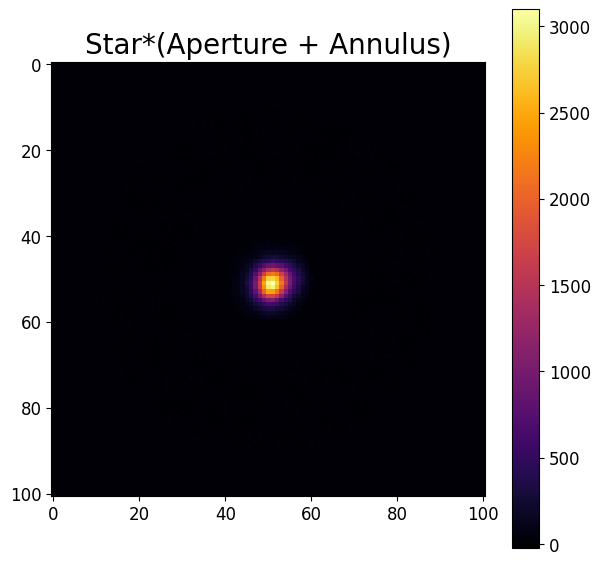

In [ ]:
def get_aperture(image_shape, radius):

    # Create a blank image (all zeros) with the specified shape
    aperture = np.zeros(image_shape, dtype=np.uint8)

    # Calculate the center of the aperture
    center_y, center_x = image_shape[0] // 2, image_shape[1] // 2

    # Create a meshgrid of indices
    y, x = np.ogrid[:image_shape[0], :image_shape[1]]

    # Calculate distances from the center for each pixel
    distances = np.sqrt((y - center_y)**2 + (x - center_x)**2)

    # Set pixels inside the aperture (based on the radius) to 1
    aperture[distances <= radius] = 1

    return aperture

def get_annulus(image_shape, inner_radius, outer_radius):

    # Create a blank image (all zeros) with the specified shape
    annulus = np.zeros(image_shape, dtype=np.uint8)

    # Calculate the center of the annulus
    center_y, center_x = image_shape[0] // 2, image_shape[1] // 2

    # Create a meshgrid of indices
    y, x = np.ogrid[:image_shape[0], :image_shape[1]]

    # Calculate distances from the center for each pixel
    distances = np.sqrt((y - center_y)**2 + (x - center_x)**2)

    # Set pixels inside the outer radius but outside the inner radius to 1
    annulus[(distances <= outer_radius) & (distances >= inner_radius)] = 1

    return annulus

aperture = get_aperture(sub_im.shape, 10)
annulus = get_annulus(sub_im.shape, 20, 40)


plt.figure(figsize=(7,7))
plt.imshow(sub_im*(annulus + aperture), cmap = 'inferno',interpolation = "None")
plt.title("Star*(Aperture + Annulus)", size = 20)
plt.colorbar()
plt.show()



In [ ]:
# N = annulus[annulus>0].size
# bg = np.sum(star*annulus)/N
# flux = np.sum((star- bg)*aperture)

# print(flux, bg)
print(aperture)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [ ]:
stars = np.array([SkyCoord('00h56m49.70s', '-37d01m38.31s'),  SkyCoord('00h56m46.43s', '-37d02m29.50s'), SkyCoord('00h56m58.27s', '-36d58m16.60s')])
ref_stars = [stars[0], stars[1], stars[2]]
print(ref_stars)

[<SkyCoord (ICRS): (ra, dec) in deg
    (14.20708333, -37.02730833)>, <SkyCoord (ICRS): (ra, dec) in deg
    (14.19345833, -37.04152778)>, <SkyCoord (ICRS): (ra, dec) in deg
    (14.24279167, -36.97127778)>]


In [ ]:
def cent_function(sub_img):
     x_cent = 0
     y_cent = 0
     for j in range(sub_im.shape[0]):
          for i in range(sub_im.shape[1]):
                  x_cent += i * sub_im[i,j]
                  y_cent += j * sub_im[i,j]
     x_cent /= np.sum(sub_im)
     y_cent /= np.sum(sub_im)
     return x_cent-sub_im.shape[1]//2, y_cent-sub_im.shape[0]//2

boxsize = 50

#To start, lets loops through each image and read it (we will only do the first few)
#For image in images


for i, f in enumerate(img_files):

    data  = read_file(f)
    header = fits.open('/content/drive/MyDrive/ASTFitsFiles/'+str(img_files[i]))[0].header
    w = WCS(header)

#In each image, we want to find the position of each star
    for j, star in enumerate(ref_stars):

        # locate the star
        ref_pos = skycoord_to_pixel(star, w)
        ref_x, ref_y = ref_pos

        # we can then put look at a box around the star to set up our flux code above
        ref_x_int, ref_y_int = ref_x.astype(int), ref_y.astype(int)

        #generate region around star
        sub_im = data[ref_y_int-boxsize: ref_y_int+boxsize+1,
                      ref_x_int-boxsize: ref_x_int+boxsize+1]
        # plt.figure(figsize=(7,7))
        # plt.imshow(sub_im, cmap = 'inferno',interpolation = "None")
        # #plt.title(f"Image #{i+1} Ref Star #{j+1}", size = 20)
        # #plt.axvline(x = sub_im.shape[0]//2, color = 'red')
        # #plt.axhline(y = sub_im.shape[0]//2, color = 'red')
        # plt.colorbar()
        # plt.show()


In [ ]:


def centroid(image):

    xvals = np.arange(image.shape[1]) - image.shape[1]//2
    centroid_x = np.sum(xvals*image**2)/np.sum(image**2)
    centroid_y = np.sum(xvals*image.T**2)/np.sum(image**2)

    return np.array([centroid_y, centroid_x])

def get_flux(sub_img, ap, an):
    N = an[an>0].size
    bg = np.sum(sub_img*an)/N
    flux = np.sum((sub_img- bg)*ap)
    return flux

def get_flux_errs(sub_img, ap, an, gain):
    N_ap = ap[ap>0].size
    N_an = an[an>0].size
    bg = np.sum(sub_img*an)/N_an
    flux = np.sum((sub_img- bg)*ap)
    a = flux/gain
    b = (1 + math.pi*0.5*(N_ap/N_an))
    un_bg = np.sqrt(np.sum((an - bg)**2) /(N_an-1))
    flux_err = np.sqrt(a + N_ap*b*un_bg)
    return flux_err


try:
    fluxes, flux_errs = np.load("tmp_fluxes.npy"), np.load("tmp_fluxes_err.npy")
except:
    #Repeating the code from above
    boxsize = 50

    sub_im = data[100-boxsize: 100+boxsize+1, 100-boxsize: 100+boxsize+1]

    #Create an aperture and annulus model
    aperture = get_aperture(sub_im.shape, 12)
    annulus = get_annulus(sub_im.shape, 20, 40)

    fluxes = np.empty((len(ref_stars),len(img_files)))
    flux_errs = np.empty_like(fluxes)


    for i, f in enumerate(img_files):

        # read the image
        data = read_file(str(f))
        header = fits.open('/content/drive/MyDrive/ASTFitsFiles/'+str(img_files[i]))[0].header
        w = WCS(header)

        for j, star in enumerate(ref_stars):


            ref_pos = skycoord_to_pixel(star, w)
            ref_x, ref_y = ref_pos
            ref_x_int, ref_y_int = ref_x.astype(int), ref_y.astype(int)
            sub_im = data[ref_y_int-boxsize: ref_y_int+boxsize+1,
                        ref_x_int-boxsize: ref_x_int+boxsize+1]
            aperture = get_aperture(sub_im.shape, 6)
            annulus = get_annulus(sub_im.shape, 12, 24)

            #sub_im = ta.center_image(data, sub_im, ref_pos)

            #Get the flux for each of the reference stars
            fluxes[j,i] = get_flux(sub_im, aperture, annulus)
            flux_errs[j,i] = get_flux_errs(sub_im, aperture, annulus, 4)


    np.save("tmp_fluxes", fluxes)
    np.save("tmp_fluxes_err", flux_errs)

print(fluxes)

[[ -380064.16666667    56922.5           59522.41666667 ...
     75914.16666667    79629.08333333    78947.16666667]
 [-2267150.16666667    28261.08333333    28785.58333333 ...
     34781.5           35996.25          36203.58333333]
 [-1268959.16666667   116922.08333333   124299.66666667 ...
    151912.83333333   161733.66666667   158007.33333333]]


In [ ]:
print((np.sum(fluxes[0])/len(fluxes[0])), np.sum(flux_errs[0])/len(flux_errs[0]))
print((np.sum(fluxes[1])/len(fluxes[1])), np.sum(flux_errs[1])/len(flux_errs[1]))
print((np.sum(fluxes[2])/len(fluxes[2])), np.sum(flux_errs[2])/len(flux_errs[2]))
print (flux_errs[0])

47875.43625192012 116.66726038653941
17790.985023041474 89.27595231003482
98028.63556067589 166.03123305046265
[1029.28937284  121.85548355  123.94644054  129.20211038   16.26505283
   15.96411398   11.13479276   10.74647181   11.4881186    14.45588614
   10.60732997  136.64006428  128.53384261  119.38977194   76.12278222
   86.41075479   38.74387108   79.68308269   84.44523282   88.72148783
   85.67223374   87.70116088   92.1542259    82.0768961    95.39705071
   99.80872256  101.15480737  100.05850826   11.56183891  131.35882269
  131.20539071  134.1210738   130.83455296  136.29589617  131.54386348
  137.70040826  135.7451195   135.91466983  133.69802756  136.39917419
  134.77756699  134.12979304  133.38044673  130.56817859  106.90553006
  106.89510323  110.02094311  110.58444408  109.543705    103.80730976
  101.94972019  103.11382707   97.10382676   95.37808377   96.18828211
   94.97728516   88.00498301   16.91898435  138.76208924  140.26650957
  138.70665187  141.22908751  131.468

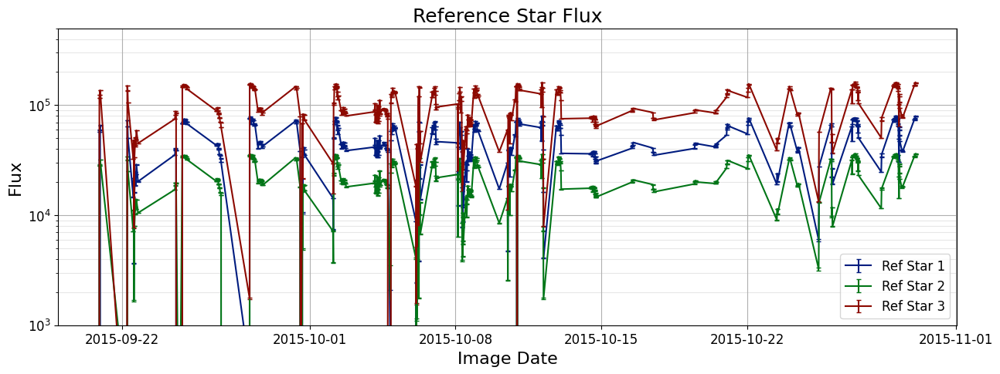

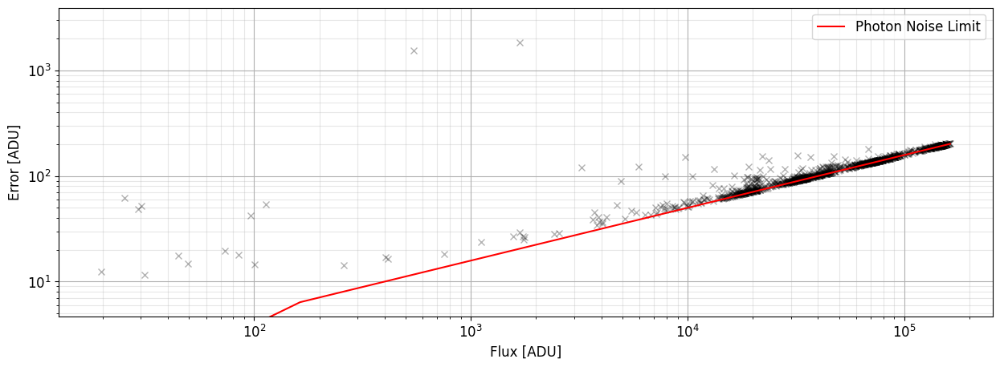

In [ ]:
plt.figure(figsize = (15, 5))
xvals = file_times#np.arange(fluxes.shape[1])
for i in range(len(ref_stars)):
    plt.errorbar(xvals, fluxes[i,:], yerr=flux_errs[i,:], label = f'Ref Star {i+1}', capsize=2, fmt = '-')
plt.yscale('log')
plt.xlabel('Image Date', size = 16)
plt.ylabel("Flux", size = 16)
plt.title("Reference Star Flux", size = 18)
plt.ylim(1e3, 5e5)
plt.legend()
plt.grid(which = 'major', alpha = 1)
plt.grid(which = 'minor', alpha = 0.3)
plt.show()

GAIN = 4
plt.figure(figsize = (15, 5))
plt.plot(fluxes.flatten(), flux_errs.flatten(), 'x', color = 'k', alpha = 0.3)
xvals = np.linspace(0, np.max(fluxes), 1000)
plt.plot(xvals, np.sqrt(xvals/GAIN), color = 'r', label = 'Photon Noise Limit')
plt.xscale('log')
plt.yscale('log')
plt.ylabel('Error [ADU]')
plt.xlabel("Flux [ADU]")
plt.legend()
plt.grid(which = 'major', alpha = 1)
plt.grid(which = 'minor', alpha = 0.3)
plt.show()


In [ ]:
for i in range(len(fluxes[0])):
  if fluxes[0][i]<10**(4.75):
    del fluxes[0][i]
    del file_times[i]
# for i in range(len(fluxes[1])):
#   if fluxes[1][i]<10**():
#     fluxes


ValueError: ignored

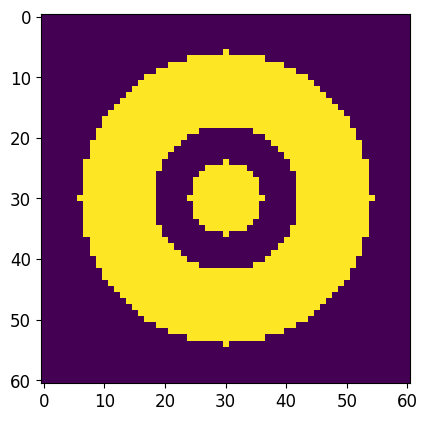

In [ ]:
ref_1 = SkyCoord('00h56m49.70s', '-37d01m38.31s')
ref_2 = SkyCoord('00h56m46.43s', '-37d02m29.50s')
ref_3 = SkyCoord('00h56m58.27s', '-36d58m16.60s')
super_nova = SkyCoord('00h57m03.190s', '-37d02m23.60s')
stars_SN = [ref_1,ref_2,ref_3,super_nova]
def calculate_snr(sub_image):
    # Replace this with your actual SNR calculation
    signal = np.mean(sub_image)  # Example: signal is the mean intensity of the sub-image
    noise = np.std(sub_image)


data = read_file('AST325-326-SN-20150920.9181.fits')
header = fits.open('/content/drive/MyDrive/ASTFitsFiles/'+str(img_files[1]))[0].header
w = WCS(header)

boxsize = 30


aperture = get_aperture((2*boxsize + 1, 2*boxsize + 1), 6)
annulus = get_annulus((2*boxsize + 1, 2*boxsize + 1), 12, 24)

plt.imshow(np.zeros_like(aperture)+aperture+annulus)
plt.show()

fluxes = np.empty((len(stars_SN),len(img_files)))
flux_errs = np.empty_like(fluxes)
SNRs = np.empty(len(img_files))
#For image in images
for i, f in enumerate(img_files):

    # read the image
    data  = read_file(str(f))
    header = fits.open('/content/drive/MyDrive/ASTFitsFiles/'+str(img_files[i]))[0].header
    w = WCS(header)

    for j, star in enumerate(stars_SN):

        # locate the star
        ref_pos = skycoord_to_pixel(star, w)
        ref_x, ref_y = ref_pos
        ref_x_int, ref_y_int = ref_x.astype(int), ref_y.astype(int)

        #generate region around star and get local centroid
        sub_im = data[ref_y_int-boxsize: ref_y_int+boxsize+1, ref_x_int-boxsize: ref_x_int+boxsize+1]
        cent = np.round(centroid(sub_im),0).astype(int)

        #Round to nearest integer, adjust by a few pixels if needed
        ref_x_int += cent[1]
        ref_y_int += cent[0]

        #Generate a new region with a better center
        sub_im = data[ref_y_int-boxsize: ref_y_int+boxsize+1,
                      ref_x_int-boxsize: ref_x_int+boxsize+1]

        aperture = get_aperture(sub_im.shape, 3*2)
        annulus = get_annulus(sub_im.shape, 6*2, 12*2)

        #Background
        bg = np.sum(sub_im*annulus)/annulus[annulus>0].size
#         plt.imshow(sub_im*annulus)
#         plt.show()
        #Compute flux
        flux = np.sum((sub_im- bg)*aperture )

        fluxes[j,i] = flux
        flux_errs[j,i] = get_flux_errs(sub_im, aperture, annulus, 4)
        if j == 3:
          N_aperture = aperture[aperture>0].size
          N_annulus = annulus[annulus>0].size
          a = (sub_im + aperture)/N_aperture
          b = (sub_im + annulus)/N_annulus
          # snr = calculate_snr(sub_image)
          # if snr > 3:
          #     print(f"The first sub-image with SNR > 3 is at index {idx}.")
          #     break
          # else:
          #     print("No sub-image with SNR > 3 found.")

#     break

#print(aperture*sub_im)

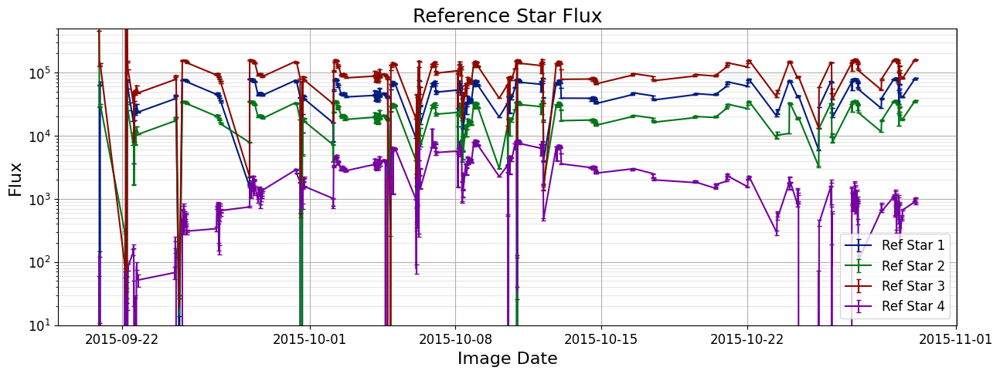

In [ ]:
plt.figure(figsize = (15, 5))
xvals = file_times#np.arange(fluxes.shape[1])
for i in range(len(stars_SN)):
    plt.errorbar(xvals, fluxes[i,:], yerr=flux_errs[i,:], label = f'Ref Star {i+1}', capsize=2, fmt = '-')
plt.yscale('log')
plt.xlabel('Image Date', size = 16)
plt.ylabel("Flux", size = 16)
plt.title("Reference Star Flux", size = 18)
plt.ylim(1e1, 5e5)
plt.legend()
plt.grid(which = 'major', alpha = 1)
plt.grid(which = 'minor', alpha = 0.3)
plt.show()

In [ ]:
import numpy as np

def calculate_snr(sub_image):
    # Replace this with your actual SNR calculation
    signal = np.mean(sub_image)  # Example: signal is the mean intensity of the sub-image
    noise = np.std(sub_image)    # Example: noise is the standard deviation of the sub-image

    # Avoid division by zero
    if noise == 0:
        return np.inf

    return signal / noise

# List of sub-images (replace with your actual sub-images)
sub_images = [...]

# Find the first sub-image with SNR greater than 3
for idx, sub_image in enumerate(sub_images):
    snr = calculate_snr(sub_image)
    if snr > 3:
        print(f"The first sub-image with SNR > 3 is at index {idx}.")
        break
else:
    print("No sub-image with SNR > 3 found.")

TypeError: ignored

In [ ]:
super_nova = SkyCoord('00h57m03.190s', '-37d02m23.60s')
SNRs = np.empty(len(img_files))
#For image in images
for i, f in enumerate(img_files):

    # read the image
    data  = read_file(str(f))
    header = fits.open('/content/drive/MyDrive/ASTFitsFiles/'+str(img_files[i]))[0].header
    w = WCS(header)
    ref_pos = skycoord_to_pixel(super_nova, w)
    ref_x, ref_y = ref_pos
    ref_x_int, ref_y_int = ref_x.astype(int), ref_y.astype(int)

    #generate region around star and get local centroid
    sub_im = data[ref_y_int-boxsize: ref_y_int+boxsize+1, ref_x_int-boxsize: ref_x_int+boxsize+1]
    cent = np.round(centroid(sub_im),0).astype(int)

    #Round to nearest integer, adjust by a few pixels if needed
    ref_x_int += cent[1]
    ref_y_int += cent[0]

    #Generate a new region with a better center
    sub_im = data[ref_y_int-boxsize: ref_y_int+boxsize+1,
                  ref_x_int-boxsize: ref_x_int+boxsize+1]

    aperture = get_aperture(sub_im.shape, 6)
    annulus = get_annulus(sub_im.shape, 12, 24)
    N_aperture = aperture[aperture>0].size
    N_annulus = annulus[annulus>0].size
    a = (sub_im + aperture)/N_aperture
    b = (sub_im + annulus)/N_annulus
    SNRs[i]=(a/b)



<ipython-input-25-bf9ec51fd94e>:32: RuntimeWarning: divide by zero encountered in divide
  SNRs[i]=(a/b)


ValueError: ignored

In [ ]:
SNRs = []
for i in range(len(img_files)):



In [ ]:

print(fluxes[3])

<ipython-input-94-6a9b93fcd402>:10: RuntimeWarning: invalid value encountered in log10
  ref_lightcurves[i,j,:] = 2.512*np.log10(fluxes[j,:]/cur_star_flux) + ref_mags[j]


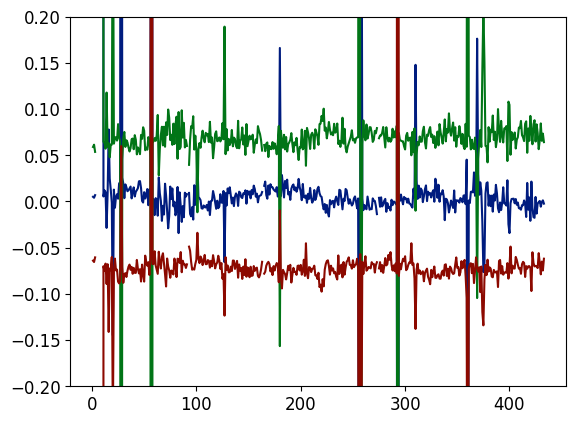

In [ ]:
ref_mags = [16.32, 17.16, 15.61]
50959.88536866359
31890.292434715815
112957.76420890939
ref_lightcurves = np.empty((len(stars_SN) - 1, len(stars_SN) - 1, fluxes.shape[1]))

for i in range(ref_lightcurves.shape[0]):
    cur_star_flux = fluxes[i,:]
    for j in range(ref_lightcurves.shape[1]):
        ref_lightcurves[i,j,:] = 2.512*np.log10(fluxes[j,:]/cur_star_flux) + ref_mags[j]


ref_lightcurves = [0.5*(ref_lightcurves[0,1]+ref_lightcurves[0,2]),
                  0.5*(ref_lightcurves[1,0]+ref_lightcurves[1,2]),
                  0.5*(ref_lightcurves[2,0]+ref_lightcurves[2,1])]

for i, curve in enumerate(ref_lightcurves):
    plt.plot(curve - ref_mags[i])
#     plt.axhline(ref_mags[0], color = 'r', linestyle = '--')
plt.ylim(-0.2, 0.2)
plt.show()

_filter = (np.abs(ref_lightcurves[0] - ref_mags[0]) < 0.15)&(np.abs(ref_lightcurves[1] - ref_mags[1]) < 0.15)&(np.abs(ref_lightcurves[2] - ref_mags[2]) < 0.15)&(fluxes[-1,:] > 0)


In [ ]:

print(fluxes)


[[-3.28841750e+05  6.28905000e+04  6.43879167e+04 ...  7.82207500e+04
   8.12505000e+04  8.14350833e+04]
 [ 3.87548633e+06  2.81756667e+04  2.87855833e+04 ...  3.47815000e+04
   3.59962500e+04  3.62035833e+04]
 [ 4.52548917e+05  1.25769167e+05  1.28797583e+05 ...  1.55978583e+05
   1.63158250e+05  1.61910083e+05]
 [-3.16666667e+01  1.33916667e+02  1.66666667e-01 ...  9.00000000e+02
   1.04216667e+03  8.52500000e+02]]


<ipython-input-112-af310309be45>:31: RuntimeWarning: invalid value encountered in log10
  SN_mags[i] = 2.512*np.log10(fluxes[2][i]/SN_flux[i]) + ref_mags[2]


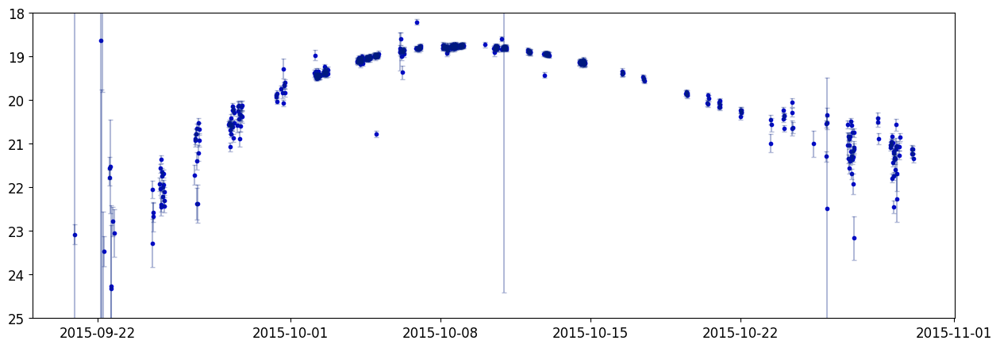

In [ ]:
def get_mag_err(SN_flux, SN_flux_err, Ref_flux1, Ref_flux2, Ref_flux3, Ref_flux_err1, Ref_flux_err2, Ref_flux_err3, Ref_mag_err1, Ref_mag_err2, Ref_mag_err3):
  un_log_SN = -2.5*(SN_flux_err/SN_flux)
  un_log_ref1 = 2.5*(Ref_flux_err1/Ref_flux1)
  mag_error_1 = np.sqrt((Ref_mag_err1)**2 + (un_log_SN)**2 + (un_log_ref1)**2)
  un_log_ref2 = 2.5*(Ref_flux_err2/Ref_flux1)
  mag_error_2 = np.sqrt((Ref_mag_err2)**2 + (un_log_SN)**2 + (un_log_ref2)**2)
  un_log_ref3 = 2.5*(Ref_flux_err3/Ref_flux1)
  mag_error_3 = np.sqrt((Ref_mag_err3)**2 + (un_log_SN)**2 + (un_log_ref3)**2)
  uncertainty_SN = ( mag_error_1+ mag_error_2 + mag_error_3 )/3
  return uncertainty_SN

SN_flux = fluxes[3]
SN_flux_err = flux_errs[3]
ref_mags = [16.32, 17.16, 15.61]
50959.88536866359
31890.292434715815
112957.76420890939

ref_mag_err = [0.07, 0.08, 0.02]
_filter = (np.abs(ref_lightcurves[0] - ref_mags[0]) < 0.15)&(np.abs(ref_lightcurves[1] - ref_mags[1]) < 0.15)&(np.abs(ref_lightcurves[2] - ref_mags[2]) < 0.15)&(fluxes[-1,:] > 0)
SN_mags = np.empty(len(SN_flux))
SN_mags_err = np.empty(len(SN_flux_err))

def quartic_function(x, a, b, c, d, e):
    return a * x**4 + b * x**3 + c * x**2 + d * x + e



for i in range(len(SN_flux)):
# #     print(2.512*np.log10(fluxes[i,:]/SN_flux)+ ref_mags[i])
    SN_mags[i] = 2.512*np.log10(fluxes[2][i]/SN_flux[i]) + ref_mags[2]
    SN_mags_err[i] = get_mag_err(SN_flux[i], SN_flux_err[i], fluxes[0][i], fluxes[1][i], fluxes[2][i], flux_errs[0][i], flux_errs[1][i], flux_errs[2][i], ref_mag_err[0], ref_mag_err[1], ref_mag_err[2])

_filter = _filter&(SN_mags > 18)&(SN_mags < 25)

file_times_numeric = np.array([f.timestamp() for f in file_times])

plt.figure(figsize = (15,5))
# for i in range(SN_mags.shape[0]):
plt.plot(file_times, SN_mags, '.', color ='blue')
#popt, pcov = curve_fit(func, xdata, ydata)
#popt, pcov = curve_fit(curve_function, file_times, SN_mags)
#curve_fitted_SN_mag = curve_function(file_times, popt[0], popt[1], popt[2])
#plt.plot(file_times, curve_fitted_SN_mag)

#coefs, cov = np.polyfit(file_times_numeric[_filter],SN_lightcurve[_filter],3, w = 1/SN_lightcurve_err[_filter]**2, cov = True)
# plt.plot(file_times,mean_SN_mags, 'x', color ='k')
#np.save("observation_times", file_times[_filter])
#np.save("light_curve", mean_SN_mags[_filter])
# plt.yscale('log')
plt.errorbar(file_times, SN_mags, yerr = SN_mags_err, fmt = '.', capsize = 2, alpha = 0.3)
plt.ylim(18,25)
plt.gca().invert_yaxis()
plt.show()
# print(SN_flux)
# print(len(SN_flux_err))
# print(len(SN_mags))
# print((len(SN_mags_err)))


In [ ]:
import numpy as np

def remove_nan_elements_from_lists(list1, list2, list3, list4, list5):
    """
    Remove elements containing NaN from two lists.

    Parameters:
    - list1 (list): The first input list.
    - list2 (list): The second input list.

    Returns:
    - tuple: A tuple containing two lists with NaN-containing elements removed.
    """
    non_nan_indices = [i for i, x in enumerate(list1) if not np.isnan(x)]
    new_list1 = [list1[i] for i in non_nan_indices]
    new_list2 = [list2[i] for i in non_nan_indices]
    new_list3 = [list3[i] for i in non_nan_indices]
    new_list4 = [list4[i] for i in non_nan_indices]
    new_list5 = [list5[i] for i in non_nan_indices]
    return new_list1, new_list2, new_list3, new_list4, new_list5

In [ ]:

list_of_indices = []
for i in range(len(SN_mags)):
  if math.isnan(SN_mags[i]):
    list_of_indices.append(i)
print(list_of_indices)



list_from_file_times = []
for item in file_times:
    list_from_file_times.append(item)


list_from_SN_flux = []
for item in SN_flux:
    list_from_SN_flux.append(item)


list_from_SN_flux_err = []
for item in SN_flux_err:
  list_from_SN_flux_err.append(item)


list_from_SN_mags = []
for item in SN_mags:
    list_from_SN_mags.append(item)


list_from_SN_mags_err = []
for item in SN_mags_err:
    list_from_SN_mags_err.append(item)

# list_of_indices_2 = []
# for i in range(len(list_from_SN_mags)):
#   if math.isnan(SN_mags[i]):
#     list_of_indices_2.append(i)
#     list_from_file_times.pop(i)
#     list_from_SN_flux.pop(i)
#     list_from_SN_flux_err.pop(i)
#     list_from_SN_mags.pop(i)
#     list_from_SN_mags_err.pop(i)
# print(list_of_indices_2)

# print(list_from_file_times)
# print(list_from_SN_flux)
# print(list_from_SN_flux_err)
# print(list_from_SN_mags)
# print(list_from_SN_mags_err)
print(len(list_from_SN_mags))




[0, 3, 6, 10, 11, 17, 20, 21, 28, 157, 164, 259, 369, 376]
434


In [ ]:
new_SN_mags, new_SN_mags_err, new_SN_flux, new_SN_flux_err, new_file_times = remove_nan_elements_from_lists(list_from_SN_mags, list_from_SN_mags_err, list_from_SN_flux, list_from_SN_flux_err, list_from_file_times)


In [ ]:
print(len(new_SN_mags))

420


In [ ]:
header = fits.open('/content/drive/MyDrive/ASTFitsFiles/AST325-326-SN-20150922.1458.fits')[0].header
date_reference = datetime.fromisoformat(header["DATE-OBS"])
file_times_seconds = np.empty(len(new_file_times))
for i in range(len(new_file_times)):
  file_times_seconds[i] = (new_file_times[i] - date_reference).total_seconds()
print(len(file_times_seconds))


420


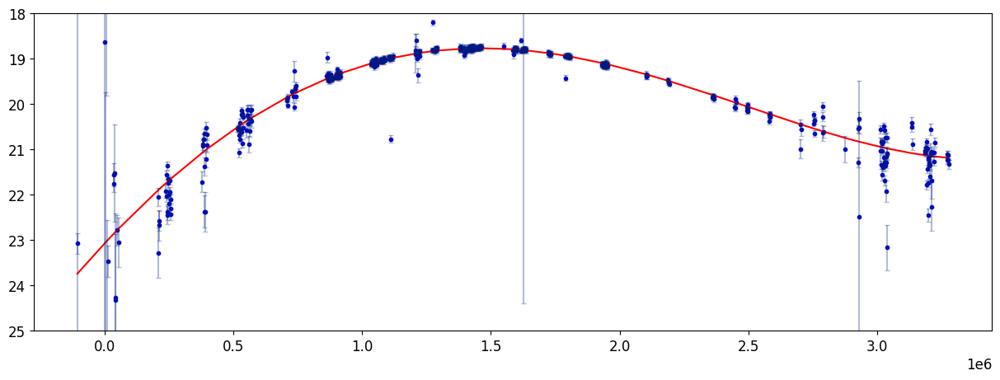

18.77184104416782
1463737.0


In [ ]:
# def get_mag_err(SN_flux, SN_flux_err, Ref_flux1, Ref_flux2, Ref_flux3, Ref_flux_err1, Ref_flux_err2, Ref_flux_err3, Ref_mag_err1, Ref_mag_err2, Ref_mag_err3):
#   un_log_SN = -2.5*(SN_flux_err/SN_flux)
#   un_log_ref1 = 2.5*(Ref_flux_err1/Ref_flux1)
#   mag_error_1 = np.sqrt((Ref_mag_err1)**2 + (un_log_SN)**2 + (un_log_ref1)**2)
#   un_log_ref2 = 2.5*(Ref_flux_err2/Ref_flux1)
#   mag_error_2 = np.sqrt((Ref_mag_err2)**2 + (un_log_SN)**2 + (un_log_ref2)**2)
#   un_log_ref3 = 2.5*(Ref_flux_err3/Ref_flux1)
#   mag_error_3 = np.sqrt((Ref_mag_err3)**2 + (un_log_SN)**2 + (un_log_ref3)**2)
#   uncertainty_SN = ( mag_error_1 + mag_error_2 + mag_error_3 )/3
#   return uncertainty_SN



ref_mags = [16.32, 17.16, 15.61]
# 47875.43625192012 116.66726038653941
# 17790.985023041474 89.27595231003482
# 98028.63556067589 166.03123305046265

ref_mag_err = [0.07, 0.08, 0.02]

_filter = _filter&(SN_mags > 18)&(SN_mags < 25)

def quartic_function(x, a, b, c, d, e):
    return a * x**4 + b * x**3 + c * x**2 + d * x + e

popt, pcov = curve_fit(quartic_function, file_times_seconds, new_SN_mags, sigma = new_SN_mags_err, absolute_sigma = True)
curve_fit_SN_mags= quartic_function(file_times_seconds, popt[0], popt[1], popt[2], popt[3], popt[4])
plt.figure(figsize = (15,5))
# for i in range(SN_mags.shape[0]):
plt.plot(file_times_seconds, new_SN_mags, '.', color ='blue')
plt.plot(file_times_seconds, curve_fit_SN_mags, color = 'red')
plt.errorbar(file_times_seconds, new_SN_mags, yerr = new_SN_mags_err, fmt = '.', capsize = 2, alpha = 0.3)
plt.ylim(18,25)
plt.gca().invert_yaxis()
plt.show()
print(min(curve_fit_SN_mags))
min_index = np.argmin(curve_fit_SN_mags)
x_index = file_times_seconds[min_index]
print(x_index)

In [ ]:
import numpy as np
new_SN_mags = np.array(new_SN_mags)

new_SN_mags_err = np.array(new_SN_mags_err)
new_SN_flux = np.array(new_SN_flux)
new_SN_flux_err = np.array(new_SN_flux_err)
file_times_seconds = np.array(file_times_seconds)
# Example arrays
SNRs =  np.array(new_SN_mags)/np.array(new_SN_mags_err)

# Create a boolean mask for values greater than 3
mask = SNRs >= 3
_filter = (new_SN_mags > 18)&(new_SN_mags < 24)
# Apply the mask to both arrays
filtered_SNRs = SNRs[mask]
filtered_new_SN_mags = new_SN_mags[mask]
filtered_new_SN_mags_err = new_SN_mags_err[mask]
filtered_new_SN_flux = new_SN_flux[mask]
filtered_new_SN_flux_err = new_SN_flux_err[mask]
filtered_file_times_seconds = file_times_seconds[mask]


In [ ]:

print(len(SNRs))
print(SNRs[2])
print()

420
45.63200103967509



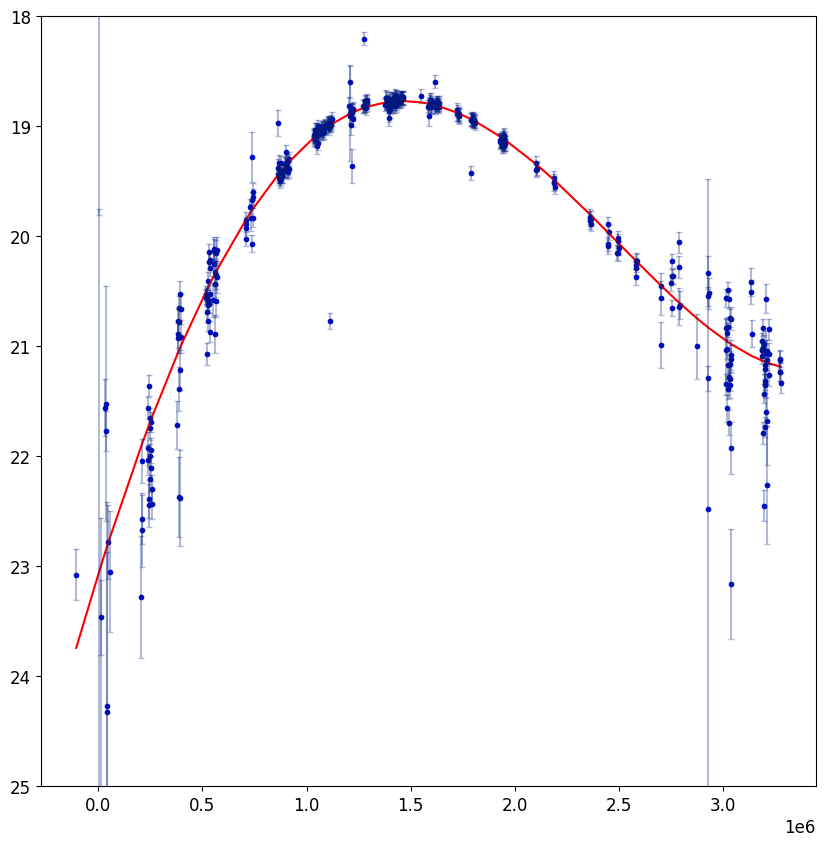

In [ ]:
popt, pcov = curve_fit(quartic_function, filtered_file_times_seconds, filtered_new_SN_mags, sigma = filtered_new_SN_mags_err, absolute_sigma = True)
filtered_curve_fit_SN_mags= quartic_function(filtered_file_times_seconds, popt[0], popt[1], popt[2], popt[3], popt[4])
plt.figure(figsize = (10,10))

# for i in range(SN_mags.shape[0]):
plt.plot(filtered_file_times_seconds, filtered_new_SN_mags, '.', color ='blue')
plt.plot(filtered_file_times_seconds, filtered_curve_fit_SN_mags, color = 'red')
plt.errorbar(filtered_file_times_seconds, filtered_new_SN_mags, yerr = filtered_new_SN_mags_err, fmt = '.', capsize = 2, alpha = 0.3)
plt.ylim(18,25)
plt.gca().invert_yaxis()
plt.show()

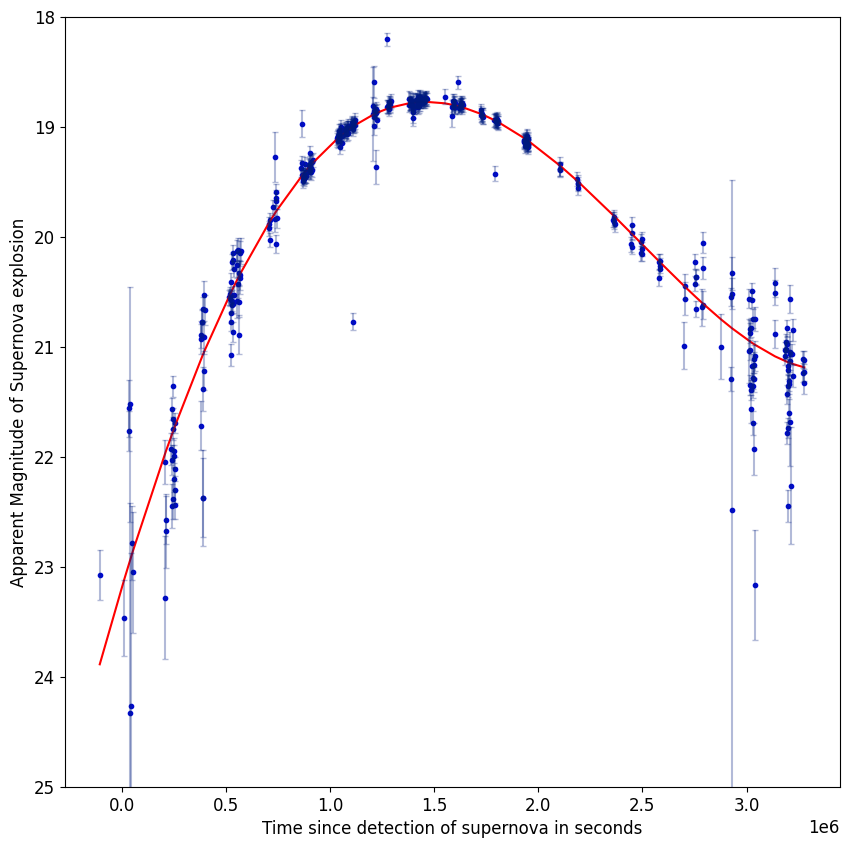

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Assuming filtered_file_times_seconds, filtered_new_SN_mags, and filtered_new_SN_mags_err are defined somewhere
_filter = (filtered_new_SN_mags > 18) & (filtered_new_SN_mags < 25)
filtered_file_times_seconds = filtered_file_times_seconds[_filter]
filtered_new_SN_mags = filtered_new_SN_mags[_filter]
filtered_new_SN_mags_err = filtered_new_SN_mags_err[_filter]
filtered_new_SN_flux_err = filtered_new_SN_flux_err[_filter]

def quartic_function(x, a, b, c, d, e):
    return a * x**4 + b * x**3 + c * x**2 + d * x + e

popt, pcov = curve_fit(quartic_function, filtered_file_times_seconds, filtered_new_SN_mags, sigma=filtered_new_SN_mags_err, absolute_sigma=True)
filtered_curve_fit_SN_mags = quartic_function(filtered_file_times_seconds, popt[0], popt[1], popt[2], popt[3], popt[4])

plt.figure(figsize=(10, 10))
plt.plot(filtered_file_times_seconds, filtered_new_SN_mags, '.', color='blue')
plt.plot(filtered_file_times_seconds, filtered_curve_fit_SN_mags, color='red')
plt.xlabel("Time since detection of supernova in seconds")
plt.ylabel("Apparent Magnitude of Supernova explosion")
plt.errorbar(filtered_file_times_seconds, filtered_new_SN_mags, yerr=filtered_new_SN_mags_err, fmt='.', capsize=2, alpha=0.3)
plt.ylim(18, 25)  # Set the y-axis limits
plt.gca().invert_yaxis()
plt.show()
# print(min(curve_fit_SN_mags))
# min_index = np.argmin(filtered_curve_fit_SN_mags)
# x_index = filtered_file_times_seconds[min_index]
# print(x_index)

In [ ]:
# ref_mags = [16.32, 17.16, 15.61]
# 50959.88536866359
# 31890.292434715815
# 112957.76420890939

# ref_mag_err = [0.07, 0.08, 0.02]

# _filter = (new_SN_mags > 18)&(new_SN_mags < 25)

# def quartic_function(x, a, b, c, d, e):
#     return a * x**4 + b * x**3 + c * x**2 + d * x + e

# popt, pcov = curve_fit(quartic_function, file_times_seconds[ _filter], new_SN_mags[ _filter], sigma = new_SN_mags_err[ _filter], absolute_sigma = True)
# curve_fit_SN_mags= quartic_function(file_times_seconds[ _filter], popt[0], popt[1], popt[2], popt[3], popt[4])
# plt.figure(figsize = (15,5))
# # for i in range(SN_mags.shape[0]):
# plt.plot(file_times_seconds[ _filter], new_SN_mags[ _filter], '.', color ='blue')
# plt.plot(file_times_seconds[ _filter], curve_fit_SN_mags, color = 'red')
# plt.errorbar(file_times_seconds[ _filter], new_SN_mags[ _filter], yerr = new_SN_mags_err[ _filter], fmt = '.', capsize = 2, alpha = 0.3)
# plt.ylim(18,25)
# plt.gca().invert_yaxis()
# plt.show()


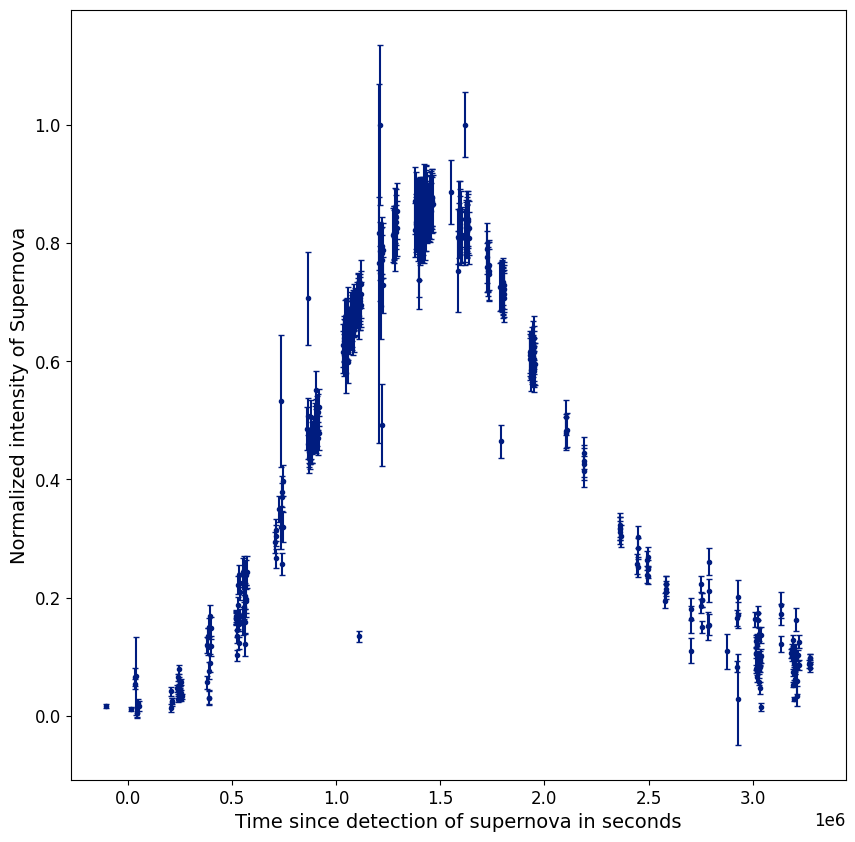

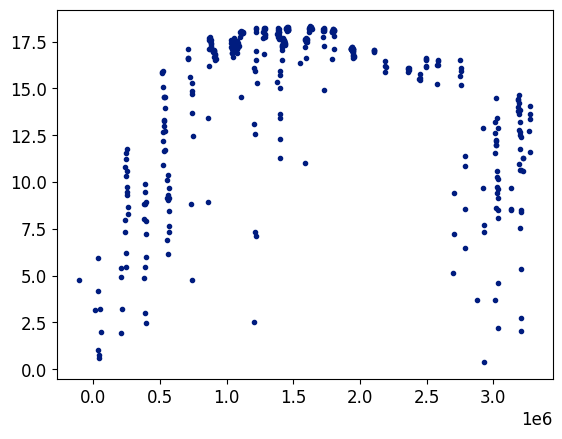

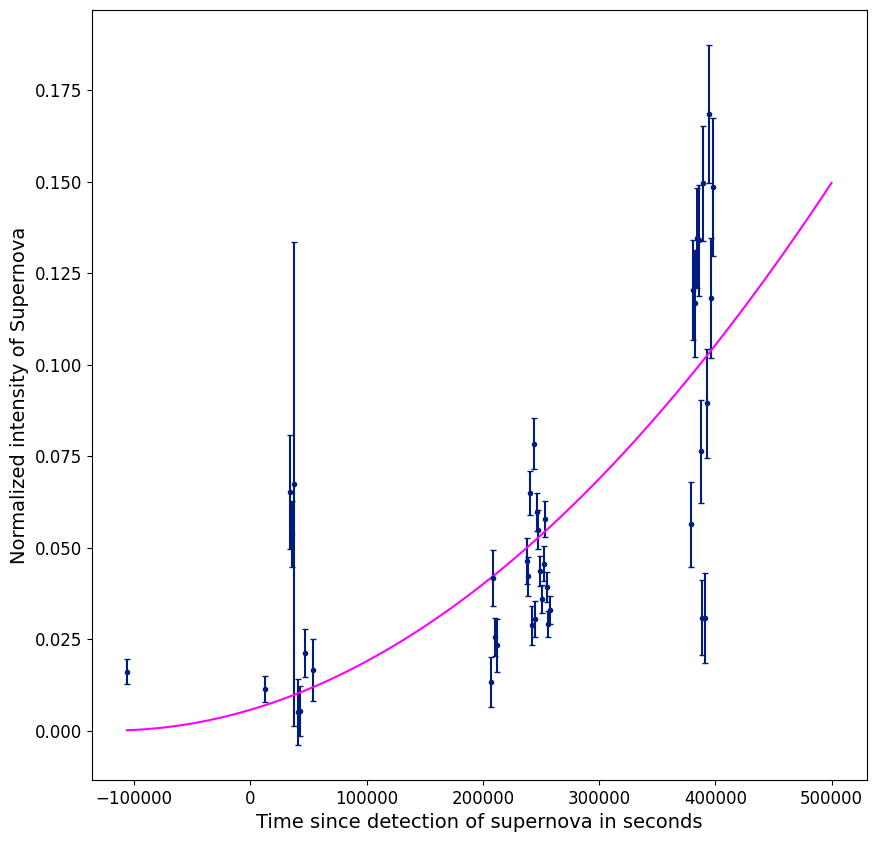

(array([0]),)
-120785.45052259577


In [ ]:
def power_curve(t, c, t_1):
  return c*((t-t_1))**2

def flux_err_for_power(mag, mag_err):
  return 0.4*(10**(-0.4*mag))*math.log(10)*mag_err


x = filtered_file_times_seconds.copy()
y = filtered_new_SN_mags.copy()
yerr = filtered_new_SN_mags_err.copy()

mag_filter = (y > 18.5)&(y<30)
x = x[mag_filter]
y = y[mag_filter]
yerr = yerr[mag_filter]

yerr = flux_err_for_power(y, yerr)
y = 10**(-0.4*y)
ymax = np.max(y)
y /= ymax
yerr /= ymax

# bright_filter = (y > 18.5)&(y<30)
# x = x[mag_filter]
# y = y[mag_filter]
# yerr = yerr[mag_filter]

plt.figure(figsize=(10, 10))
plt.errorbar(x,y,yerr=yerr, fmt = '.', capsize = 2)
plt.xlabel('Time since detection of supernova in seconds', fontsize = 14)
plt.ylabel('Normalized intensity of Supernova', fontsize = 14)
plt.show()

plt.plot(x, y/yerr, '.')

plt.show()



mask = x < 0.5e6
x = x[mask]
y = y[mask]
yerr = yerr[mask]
popt, pcov = curve_fit(power_curve, x,y)
curv_fit_x = np.arange(x_fit[0], 500000, 1)
curve_fit_y_values = power_curve(curv_fit_x, popt[0], popt[1])

plt.figure(figsize=(10, 10))
plt.errorbar(x,y,yerr=yerr, fmt = '.', capsize = 2)
plt.plot(curv_fit_x, curve_fit_y_values, color = 'magenta')
plt.xlabel('Time since detection of supernova in seconds', fontsize = 14)
plt.ylabel('Normalized intensity of Supernova', fontsize = 14)
plt.show()
# masked_SN_mags= filtered_new_SN_mags[mask]
# power_fit_flux = 10**(-0.4 *masked_SN_mags)
# newest_flux_normalised = 10**(-0.4 *masked_SN_mags)/max(power_fit_flux)
# x_fit = filtered_file_times_seconds[mask]
# masked_SN_mags_err = filtered_new_SN_mags_err[mask]

# SN_flux_err_for_power = []

# for i in range(len(masked_SN_mags)):
#     SN_flux_err_for_power.append(flux_err_for_power(masked_SN_mags[i],masked_SN_mags_err[i]))

# plt.scatter(x_fit, newest_flux_normalised, color='green')

# popt, pcov = curve_fit(power_curve, x_fit,newest_flux_normalised)
# curv_fit_x = np.arange(x_fit[0], 500000, 1)
# curve_fit_y_values = power_curve(curv_fit_x, popt[0], popt[1])
# plt.plot(curv_fit_x, curve_fit_y_values, color = 'magenta')
# plt.ylabel("Normalised  Intensity of Supernova")
# plt.xlabel("Seconds since first detection")

# plt.errorbar(x_fit, newest_flux_normalised, SN_flux_err_for_power, fmt='.', capsize=2, alpha=0.3, color = 'pink')

np.where(min(curve_fit_y_values))
print(np.where(min(curve_fit_y_values)))
print(popt[1])


In [ ]:
1913397.12+-120785.45052259577

1792611.6694774043

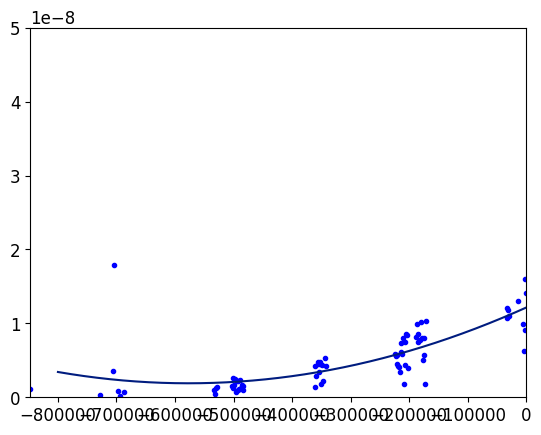

[22.42774887 23.61906654 21.13497356 19.37009839 22.69515517 24.43577683
 22.79475143 22.55989635 23.42535606 22.23583191 22.16071858 22.02058138
 22.26281719 21.43454433 21.98601942 21.52330694 22.91542915 21.64980413
 21.65305828 22.59017907 22.38141329 21.56808632 22.19792572 21.93029868
 22.08451702 22.47755222 22.1816197  20.95113863 21.36010962 20.78872894
 20.86838249 21.18421024 20.79675692 20.85897843 21.89806334 20.88461036
 21.65139853 20.68135692 20.91871088 20.59157192 20.63987707 20.61831147
 20.87554247 20.9332995  20.95927626 21.18048967 20.338488   20.5401646
 20.57482778 20.24233203 21.8977127  20.3100194  20.9123626  20.16088277
 20.18543367 21.00952901 20.22034973 20.01394837 20.16848532 20.31566591
 20.28209914 19.98144308 20.23862667 20.75751644 20.60601564 20.24169255
 21.87030013 19.959133   19.79819262 19.92158072 19.81588214 19.90308883
 19.70834287 20.01630358 20.51045634 20.10892778 19.48870076 19.62410734
 19.82911098 19.63799641 19.41348545 18.97105853 19.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

def quadratic(x, a, b, c):
  return a*x**2+b*x+c


mask = filtered_file_times_seconds < 0.5
x_fit = filtered_file_times_seconds[mask]
#y_fit = power_fit_flux[mask]
y_err_fit = filtered_new_SN_flux_err[mask]
power_SN_mags_fit = filtered_new_SN_mags[mask]
power_fit_flux = 10**(-0.4 * power_SN_mags_fit)
plt.xlim(filtered_file_times_seconds[0],0)
y_fit = power_fit_flux
plt.ylim(0.0e-7,0.5e-7)
xdata = np.arange(-800000,0)
plt.plot(x_fit, y_fit, '.', color='blue')
popt, pcov = curve_fit(quadratic, x_fit, y_fit)
filtered_curve_fit_SN_flux = quadratic(filtered_file_times_seconds, popt[0], popt[1], popt[2])
#plt.plot(filtered_file_times_seconds, filtered_curve_fit_SN_flux, '.', color='red')
plt.plot(xdata, quadratic(xdata, popt[0], popt[1], popt[2]))
plt.show()

print(filtered_new_SN_mags)
print(min( quadratic(xdata, popt[0], popt[1], popt[2])))

In [ ]:
print(x_fit)
print(mask)

[-847127. -728693. -706614. -705191. -703682. -699768. -698247. -693628.
 -686940. -534092. -532329. -530655. -529111. -503252. -501858. -500398.
 -498875. -497397. -495976. -494612. -493261. -491968. -490379. -488818.
 -487332. -486043. -484753. -483499. -361697. -360186. -358743. -356661.
 -355140. -353597. -352130. -351983. -350033. -348611. -346755. -344387.
 -342712. -224276. -222967. -221658. -220407. -219175. -217848. -216077.
 -214611. -213289. -211932. -210651. -209195. -207911. -206448. -205077.
 -203852. -202200. -189178. -187422. -185889. -184204. -182386. -180671.
 -178979. -177229. -175586. -174185. -172384. -170777.  -33606.  -32317.
  -30986.  -29793.  -14696.   -6158.   -4615.   -3008.   -1653.       0.]
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  